In [1]:
#%matplotlib notebook
import os
from datetime import datetime
from pathlib import Path
import math
import time
import numpy as np
import pandas as pd
from tabulate import tabulate
from matplotlib import pyplot as plt
import functools
import json

from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error

import importlib
import plt_utils as pu
import evaluator as ev
import SMOTER as smtr
import forecasting_models as fmod
import relevance as rlv
import prepare_data as dprep
import GAN as gmod

#allows update import custom modules without having to restart kernel:
importlib.reload(pu)
importlib.reload(ev)
importlib.reload(smtr)
importlib.reload(fmod)
importlib.reload(rlv)
importlib.reload(dprep)
importlib.reload(gmod)

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import warnings
warnings.filterwarnings('ignore')

2023-11-04 23:22:34.450629: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-11-04 23:22:34.577961: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-11-04 23:22:34.577977: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-11-04 23:22:35.054662: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-

**Importing Data**

In [2]:
#If tvar and/or fvars not specified it'll just opt for the default specified by meta
def import_data(file_name, tvar=None, fvars=None):
    with open('data/meta.json','r') as file:
        meta = json.load(file)
    meta = meta[file_name]
    ds_name = meta['name']
    if file_name == 'london_merged.csv':
        #this dataset is multi-variate, can call this function with specified targets/features or just use defaults
        if not tvar: tvar = meta['tv']
        if not fvars: fvars = [tvar]
        df=pd.read_csv(f"data/{file_name}")
        df=df.reset_index()[fvars if tvar in fvars else [tvar] + fvars]
    elif "cyclone_speed" in file_name:
        tvar = meta['tv']
        fvars = [tvar]
        #has tv Speed(knots) as well as Cyc Num
        #Cyc Num needed for applying taken to separate cyclones
        df=pd.read_csv(f"data/{file_name}")
        df=df.reset_index()[["Cyc Num",tvar]]
    else:
        #rest of the datasets are univariate and don't have headers
        tvar = meta['tv']
        fvars = [tvar]
        df=pd.read_csv(f"data/{file_name}", header=None, names=[tvar])
    return df, tvar, fvars, ds_name

#importing london_merged:
#DATA_FILE = 'london_merged.csv'
DATA_FILE = 'cyclone_speed_southpacific.csv'
df1, TVAR, FVARS, DATA_NAME = import_data(DATA_FILE)

#importing baseline:
#DATA_FILE = 'sunspot.dat'
#df1, TVAR, FVARS, DATA_NAME = import_data(DATA_FILE)

N_FVARS = len(FVARS)
print(df1)

       Cyc Num  Speed(knots)
0           14            25
1           14            25
2           14            25
3           14            30
4           14            35
...        ...           ...
12002       27            25
12003       27            25
12004       27            20
12005       27            20
12006       27            25

[12007 rows x 2 columns]


In [3]:
FORECASTERS = ["LSTM", "CNN"]

In [4]:
import recorder as rec
importlib.reload(rec)
to_save = {'forecast_models': False,
           'forecast_results': False,
           'resample_models': False, #best GANs 
           'resample_results': False,
           'eval_results': True, #evaluation metrics
           'logs': False,
           'figures': True,
           'parameters': True,
          }

RECORDER = rec.ExperimentRecorder(to_save, DATA_NAME, FORECASTERS)
#LOADER = rec.ExperimentLoader(to_load, "Bike")
#load results from a previous session to compare with results from this session
#base_results_dir must contain resampling results and eval results to combine results
COMBINE_RESULTS_DIR = None #"Sessions/Bike/2023-October-13 13-41-03-532984"

#set GAN_DIR to none to train a new GAN, else give it a folder path to load from
GAN_CNN_DIR = None
GAN_FNN_DIR = None
#GAN_FNN_DIR = Path("C:\\Users\\jonny\\Documents\\RA\\EVF\\code\\thesis\\resampling\\Session Data\\2023-September-28 09-51-03-210656\\resample_models")

#set FORECAST_DIR to none to train a new LSTM, else give it a folder path to load from
FORECAST_DIR = None
#FORECAST_DIR = Path("C:\\Users\\jonny\\Documents\\RA\\EVF\\code\\thesis\\resampling\\Session Data\\2023-September-28 09-51-03-210656\\forecast_models")
loadedModels = {"loadedModels": {"GanCnnDir": GAN_CNN_DIR, "GanFnnDir":GAN_FNN_DIR, "ForecastDir": FORECAST_DIR}}
RECORDER.save_param_dict(loadedModels)

**Prepare Data for Resampling/Training**
* Split dataset into train and test split
* Convert data into Taken embedded time series format

In [5]:
import prepare_data as dprep
importlib.reload(dprep)

RECORDER.log_print(f"Using data from: {DATA_FILE}")
RECORDER.log_print(f"Using feature variables: {FVARS} to predict target variable: '{TVAR}'")
RECORDER.save_param_dict({"importingData":{"dataFile":DATA_FILE,"targetVar":TVAR,"featVars":FVARS}})

fandt_array = np.array(df1[FVARS]).reshape(-1,N_FVARS)
scaler=MinMaxScaler(feature_range=(0,1))
fandt_array = fandt_array.reshape(-1,N_FVARS)
to_split = scaler.fit_transform(fandt_array) 

print(f"scaled_data: {to_split.shape}")

if DATA_NAME == "Cyclone": #append column for Cyc Num labels
    to_split = np.append(to_split, np.array(df1['Cyc Num']).reshape(-1,N_FVARS), axis=1)

#Prep Data
N_STEPS_IN = 5
N_STEPS_OUT = 5
SPLIT_RATIO = 0.7
SAMPLE_DIM = N_STEPS_IN*N_FVARS + N_STEPS_OUT


k_X, X_train, Y_train, X_test, Y_test = dprep.split_time_series(to_split, DATA_NAME, N_STEPS_IN, N_STEPS_OUT, FVARS, N_FVARS, TVAR, SPLIT_RATIO)

RECORDER.save_param_dict({"prepData":{"nStepsIn":N_STEPS_IN,"nStepsOut":N_STEPS_OUT,"splitRatio":SPLIT_RATIO}})
RECORDER.log_print(f"Embedding steps in: {N_STEPS_IN} and steps out: {N_STEPS_OUT}")
RECORDER.log_print(f"Split dataset with training ratio: {SPLIT_RATIO}")
RECORDER.log_print(f"""Split data shapes:\n\t X_train: {X_train.shape}\n\t Y_train: {Y_train.shape}\n\t X_test: {X_test.shape}\n\t Y_test: {Y_test.shape}\n\t k_X: {k_X.shape}""")

LOG: 23:22:35:913 Using data from: cyclone_speed_southpacific.csv

LOG: 23:22:35:913 Using feature variables: ['Speed(knots)'] to predict target variable: 'Speed(knots)'

scaled_data: (12007, 1)
LOG: 23:22:35:928 Embedding steps in: 5 and steps out: 5

LOG: 23:22:35:929 Split dataset with training ratio: 0.7

LOG: 23:22:35:929 Split data shapes:
	 X_train: (8398, 5, 1)
	 Y_train: (8398, 5)
	 X_test: (3600, 5, 1)
	 Y_test: (3600, 5)
	 k_X: (8398, 10)



**Relevance**

In [6]:
#give this guy a list of training target values and it will give you a function that you can input target values to get a relevance score
def getPoisRelFunc(y):
    sample_mean = np.mean(y) 
    sample_std = np.std(y)
    rel_quant = np.quantile(1/rlv.dpois(y,sample_mean),0.5)
    RECORDER.save_param_dict({"relevanceFunc":{"funcName":"Pois","funcParams":{}}})
    return functools.partial(rlv.poisRelevance, smean=sample_mean, sstd=sample_std, rshift=rel_quant)
    
def getPCHIPRelFunc(y, percs, rels):
    pchip = rlv.PCHIP_interpolator(y, percs, rels)
    RECORDER.save_param_dict({"relevanceFunc":{"funcName":"PCHIP","funcParams":{"percentages":list(percs),"rels":list(rels)}}})
    return functools.partial(rlv.PCHIPRelevance, pchip_func=pchip)

all_train_targets = np.append(Y_train[:,0],Y_train[-1,1:]) 
#RELEVANCE_THRESHOLD = 0.31
#RELEVANCE_FUNCTION = getPoisRelFunc(all_train_targets)
RELEVANCE_THRESHOLD = 0.9
pchip_percentiles = [25,95,99]#[25,50,75,95,99]
pchip_relevances = [0.0,0.75,1.0]#[0.0,0.25,0.5,0.75,1.0]
RELEVANCE_FUNCTION = getPCHIPRelFunc(all_train_targets, pchip_percentiles, pchip_relevances) 
EXTREMES_THRESHOLD = rlv.PCHIPApproxInverse(RELEVANCE_THRESHOLD, RELEVANCE_FUNCTION, 0, 0.99) #target value that intersects with RELEVANCE_THRESHOLD

COMBINE = 'first'
r_Y = RELEVANCE_FUNCTION.__call__(Y_train, combine=COMBINE)
k_Y = [val >= RELEVANCE_THRESHOLD for val in r_Y]

RECORDER.save_param_dict({"relevance":{"relThresh":RELEVANCE_THRESHOLD,"exThresh": EXTREMES_THRESHOLD}})

num_rel=k_Y.count(True)

RECORDER.log_print(f"Relevance function {RELEVANCE_FUNCTION.func.__name__} used with threshold: {RELEVANCE_THRESHOLD}")
RECORDER.log_print(f"Relevance {len(k_Y)-num_rel} common values, {num_rel} relevant values")

r_Y = np.array(r_Y)
k_Y = np.array(k_Y)
k_Xex = k_X[k_Y]
print(f"r_Y: {r_Y.shape}")
#print(r_Y)
print(f"k_Y: {k_Y.shape}")
#print(k_Y)
print(f"k_Xex: {k_Xex.shape}")

LOG: 23:22:35:949 Relevance function PCHIPRelevance used with threshold: 0.9

LOG: 23:22:35:949 Relevance 8135 common values, 263 relevant values

r_Y: (8398,)
k_Y: (8398,)
k_Xex: (263, 10)


***Plot Relevance Information***

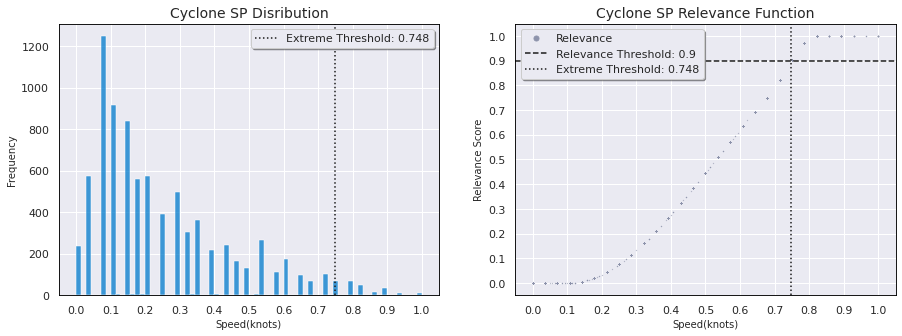

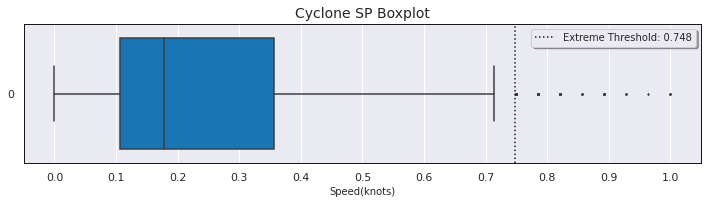

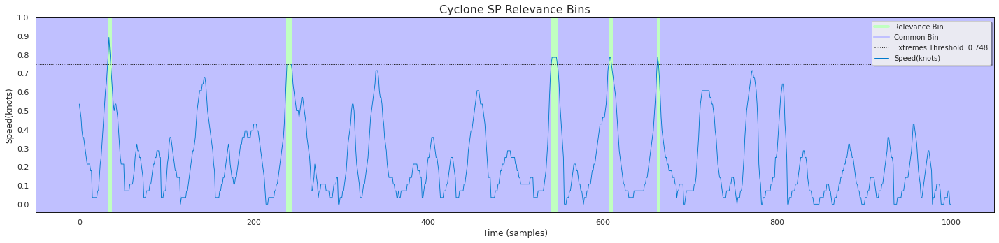

In [7]:
#Uncomment if you want to change stuff in plt_utils mid-session
#import plt_utils as pu
#importlib.reload(pu)
#Need to uncomment this is you're saving figures:
#pu.set_save_figs(True, RECORDER.figures_path)

#pu.PlotScaledData(data, TVAR)

r_Y_plot = RELEVANCE_FUNCTION.__call__(all_train_targets, combine=COMBINE) #relevance for plotting
k_Y_plot = [val >= RELEVANCE_THRESHOLD for val in r_Y_plot]
r_Y_plot = np.array(r_Y_plot)
k_Y_plot = np.array(k_Y_plot)

pu.PlotRelevance(all_train_targets, r_Y_plot, RELEVANCE_THRESHOLD, EXTREMES_THRESHOLD, TVAR, DATA_NAME)

#pu.PlotCaseWeightSurface(all_train_targets, RELEVANCE_FUNCTION, EXTREMES_THRESHOLD, 0.5, TVAR)
#pu.PlotUtilitySurface(all_train_targets, RELEVANCE_FUNCTION, EXTREMES_THRESHOLD, 0.5, TVAR)

#pu.PlotBins(all_train_targets,k_Y_plot,EXTREMES_THRESHOLD, TVAR, DATA_NAME)
pu.PlotBins(all_train_targets[3000:4000],k_Y_plot[3000:4000],EXTREMES_THRESHOLD, TVAR, DATA_NAME)

# **Resampling**

In [8]:
RES_STRATS = ["SMOTER_regular", "SMOTER_bin", "SMOTER_bin_t", "SMOTER_bin_r", "SMOTER_bin_tr", "GAN_CNN", "GAN_FNN"]

**Define GAN Models**

In [9]:
import GAN as gmod
importlib.reload(gmod)

n_gan_epochs = 120 #101
gan_batch_size = 128

CNN_GENS=None; CNN_DISCS=None; FNN_GENS=None; FNN_DISC=None

if "GAN_CNN" in RES_STRATS:
    CNN_GENS, CNN_DISCS = gmod.getGAN(k_Xex,GAN_CNN_DIR, "CNN", SAMPLE_DIM, n_gan_epochs, gan_batch_size, RECORDER.log_print)
if "GAN_FNN" in RES_STRATS:
    FNN_GENS, FNN_DISCS = gmod.getGAN(k_Xex,GAN_FNN_DIR, "FNN", SAMPLE_DIM, n_gan_epochs, gan_batch_size, RECORDER.log_print)

RECORDER.save_param_dict({"GAN":{"nEpochs":n_gan_epochs,"batchSize": gan_batch_size}})
print("$$$$ Finished training GANs $$$$")

LOG: 23:22:37:022 Training CNN GAN with 120 epochs



  0%|          | 0/3 [00:00<?, ?it/s]

Step 1: Generator loss: 1.276157557964325, discriminator loss: 1.3799453377723694
Step 2: Generator loss: 0.6263465881347656, discriminator loss: 0.6936874389648438


  0%|          | 0/3 [00:00<?, ?it/s]

Step 3: Generator loss: 0.6190364360809326, discriminator loss: 0.6934056282043457
Step 4: Generator loss: 0.6178300976753235, discriminator loss: 0.6952150464057922
Step 5: Generator loss: 0.6196257472038269, discriminator loss: 0.6902174353599548


  0%|          | 0/3 [00:00<?, ?it/s]

Step 6: Generator loss: 0.6221706867218018, discriminator loss: 0.694998025894165
Step 7: Generator loss: 0.6278528571128845, discriminator loss: 0.693454921245575
Step 8: Generator loss: 0.6361200213432312, discriminator loss: 0.6917476058006287


  0%|          | 0/3 [00:00<?, ?it/s]

Step 9: Generator loss: 0.643376350402832, discriminator loss: 0.6910441517829895
Step 10: Generator loss: 0.6534879207611084, discriminator loss: 0.6907614469528198
Step 11: Generator loss: 0.6640058755874634, discriminator loss: 0.6858252286911011


  0%|          | 0/3 [00:00<?, ?it/s]

Step 12: Generator loss: 0.6740570068359375, discriminator loss: 0.6878408193588257
Step 13: Generator loss: 0.6843506693840027, discriminator loss: 0.688188374042511
Step 14: Generator loss: 0.6987614631652832, discriminator loss: 0.6871787905693054


  0%|          | 0/3 [00:00<?, ?it/s]

Step 15: Generator loss: 0.7049568295478821, discriminator loss: 0.6882405877113342
Step 16: Generator loss: 0.7154792547225952, discriminator loss: 0.6881396770477295
Step 17: Generator loss: 0.7248226404190063, discriminator loss: 0.6896313428878784


  0%|          | 0/3 [00:00<?, ?it/s]

Step 18: Generator loss: 0.7364610433578491, discriminator loss: 0.6891748905181885
Step 19: Generator loss: 0.7472172975540161, discriminator loss: 0.6899194717407227
Step 20: Generator loss: 0.755800187587738, discriminator loss: 0.6901846528053284


  0%|          | 0/3 [00:00<?, ?it/s]

Step 21: Generator loss: 0.7687147855758667, discriminator loss: 0.6898636817932129
Step 22: Generator loss: 0.7785202264785767, discriminator loss: 0.6903757452964783
Step 23: Generator loss: 0.788966178894043, discriminator loss: 0.6910433769226074


  0%|          | 0/3 [00:00<?, ?it/s]

Step 24: Generator loss: 0.7946516871452332, discriminator loss: 0.6897138953208923
Step 25: Generator loss: 0.8007768392562866, discriminator loss: 0.6898120641708374
Step 26: Generator loss: 0.8056116700172424, discriminator loss: 0.6833651065826416


  0%|          | 0/3 [00:00<?, ?it/s]

Step 27: Generator loss: 0.809469997882843, discriminator loss: 0.6888415813446045
Step 28: Generator loss: 0.8105645179748535, discriminator loss: 0.6887015700340271
Step 29: Generator loss: 0.8096023201942444, discriminator loss: 0.6943416595458984


  0%|          | 0/3 [00:00<?, ?it/s]

Step 30: Generator loss: 0.8068414926528931, discriminator loss: 0.6881279945373535
Step 31: Generator loss: 0.8028526306152344, discriminator loss: 0.6886905431747437
Step 32: Generator loss: 0.7972093224525452, discriminator loss: 0.6892558336257935


  0%|          | 0/3 [00:00<?, ?it/s]

Step 33: Generator loss: 0.7902196645736694, discriminator loss: 0.6886027455329895
Step 34: Generator loss: 0.7827934622764587, discriminator loss: 0.6887301206588745
Step 35: Generator loss: 0.7730554938316345, discriminator loss: 0.696101188659668


  0%|          | 0/3 [00:00<?, ?it/s]

Step 36: Generator loss: 0.7635245323181152, discriminator loss: 0.6907223463058472
Step 37: Generator loss: 0.7511600852012634, discriminator loss: 0.6923491954803467
Step 38: Generator loss: 0.7368195652961731, discriminator loss: 0.6959170699119568


  0%|          | 0/3 [00:00<?, ?it/s]

Step 39: Generator loss: 0.7280322909355164, discriminator loss: 0.6953681707382202
Step 40: Generator loss: 0.718153715133667, discriminator loss: 0.6992679834365845
Step 41: Generator loss: 0.7087921500205994, discriminator loss: 0.6917390823364258


  0%|          | 0/3 [00:00<?, ?it/s]

Step 42: Generator loss: 0.7020854949951172, discriminator loss: 0.7012451887130737
Step 43: Generator loss: 0.6964565515518188, discriminator loss: 0.701707124710083
Step 44: Generator loss: 0.6940456032752991, discriminator loss: 0.7027970552444458


  0%|          | 0/3 [00:00<?, ?it/s]

Step 45: Generator loss: 0.6897628903388977, discriminator loss: 0.7017070055007935
Step 46: Generator loss: 0.6876986622810364, discriminator loss: 0.700864315032959
Step 47: Generator loss: 0.6861286163330078, discriminator loss: 0.6958029270172119


  0%|          | 0/3 [00:00<?, ?it/s]

Step 48: Generator loss: 0.6878015398979187, discriminator loss: 0.6974544525146484
Step 49: Generator loss: 0.6894675493240356, discriminator loss: 0.6931861639022827
Step 50: Generator loss: 0.6908446550369263, discriminator loss: 0.6968529224395752


  0%|          | 0/3 [00:00<?, ?it/s]

Step 51: Generator loss: 0.6918046474456787, discriminator loss: 0.685690701007843
Step 52: Generator loss: 0.6958243250846863, discriminator loss: 0.6837334036827087
Step 53: Generator loss: 0.6998690366744995, discriminator loss: 0.6719837188720703


  0%|          | 0/3 [00:00<?, ?it/s]

Step 54: Generator loss: 0.7025036215782166, discriminator loss: 0.6718059778213501
Step 55: Generator loss: 0.7066332697868347, discriminator loss: 0.6685871481895447
Step 56: Generator loss: 0.7148340344429016, discriminator loss: 0.6640392541885376


  0%|          | 0/3 [00:00<?, ?it/s]

Step 57: Generator loss: 0.7096931338310242, discriminator loss: 0.6593413352966309
Step 58: Generator loss: 0.7105885744094849, discriminator loss: 0.6547929048538208
Step 59: Generator loss: 0.7085005640983582, discriminator loss: 0.6507962346076965


  0%|          | 0/3 [00:00<?, ?it/s]

Step 60: Generator loss: 0.7101926803588867, discriminator loss: 0.6465065479278564
Step 61: Generator loss: 0.7108373045921326, discriminator loss: 0.64329594373703
Step 62: Generator loss: 0.7100111842155457, discriminator loss: 0.6383405923843384


  0%|          | 0/3 [00:00<?, ?it/s]

Step 63: Generator loss: 0.7070500254631042, discriminator loss: 0.6384223699569702
Step 64: Generator loss: 0.7010715007781982, discriminator loss: 0.636168360710144
Step 65: Generator loss: 0.6977511048316956, discriminator loss: 0.6368395090103149


  0%|          | 0/3 [00:00<?, ?it/s]

Step 66: Generator loss: 0.6884548664093018, discriminator loss: 0.6369523406028748
Step 67: Generator loss: 0.6823624968528748, discriminator loss: 0.6389070749282837
Step 68: Generator loss: 0.6683259010314941, discriminator loss: 0.6432462930679321


  0%|          | 0/3 [00:00<?, ?it/s]

Step 69: Generator loss: 0.6657553315162659, discriminator loss: 0.6435127258300781
Step 70: Generator loss: 0.6593998670578003, discriminator loss: 0.6427789926528931
Step 71: Generator loss: 0.6547237038612366, discriminator loss: 0.6459610462188721


  0%|          | 0/3 [00:00<?, ?it/s]

Step 72: Generator loss: 0.6537087559700012, discriminator loss: 0.6442936658859253
Step 73: Generator loss: 0.6569578647613525, discriminator loss: 0.6416753530502319
Step 74: Generator loss: 0.6662044525146484, discriminator loss: 0.6421453356742859


  0%|          | 0/3 [00:00<?, ?it/s]

Step 75: Generator loss: 0.6747232675552368, discriminator loss: 0.6326833367347717
Step 76: Generator loss: 0.6856995820999146, discriminator loss: 0.6253299713134766
Step 77: Generator loss: 0.6987451314926147, discriminator loss: 0.6147332191467285


  0%|          | 0/3 [00:00<?, ?it/s]

Step 78: Generator loss: 0.706756055355072, discriminator loss: 0.6134617924690247
Step 79: Generator loss: 0.7153886556625366, discriminator loss: 0.6089960336685181
Step 80: Generator loss: 0.7151716947555542, discriminator loss: 0.6092068552970886


  0%|          | 0/3 [00:00<?, ?it/s]

Step 81: Generator loss: 0.7213640809059143, discriminator loss: 0.6058347225189209
Step 82: Generator loss: 0.7157569527626038, discriminator loss: 0.604917049407959
Step 83: Generator loss: 0.712486207485199, discriminator loss: 0.6123638153076172


  0%|          | 0/3 [00:00<?, ?it/s]

Step 84: Generator loss: 0.6953756809234619, discriminator loss: 0.615288257598877
Step 85: Generator loss: 0.6822539567947388, discriminator loss: 0.6230956315994263
Step 86: Generator loss: 0.6764699220657349, discriminator loss: 0.629890501499176


  0%|          | 0/3 [00:00<?, ?it/s]

Step 87: Generator loss: 0.6708000898361206, discriminator loss: 0.6314858198165894
Step 88: Generator loss: 0.6694166660308838, discriminator loss: 0.6336786150932312
Step 89: Generator loss: 0.6681520342826843, discriminator loss: 0.6317760944366455


  0%|          | 0/3 [00:00<?, ?it/s]

Step 90: Generator loss: 0.6817976236343384, discriminator loss: 0.6291881799697876
Step 91: Generator loss: 0.6959673166275024, discriminator loss: 0.626511812210083
Step 92: Generator loss: 0.713318407535553, discriminator loss: 0.6151377558708191


  0%|          | 0/3 [00:00<?, ?it/s]

Step 93: Generator loss: 0.7312049865722656, discriminator loss: 0.6116234660148621
Step 94: Generator loss: 0.750755786895752, discriminator loss: 0.6048753261566162
Step 95: Generator loss: 0.7715598940849304, discriminator loss: 0.5960498452186584


  0%|          | 0/3 [00:00<?, ?it/s]

Step 96: Generator loss: 0.791843831539154, discriminator loss: 0.5892106294631958
Step 97: Generator loss: 0.8120755553245544, discriminator loss: 0.5816972255706787
Step 98: Generator loss: 0.8311683535575867, discriminator loss: 0.5720359086990356


  0%|          | 0/3 [00:00<?, ?it/s]

Step 99: Generator loss: 0.8494048118591309, discriminator loss: 0.5668233633041382
Step 100: Generator loss: 0.8649775385856628, discriminator loss: 0.5631300210952759
Step 101: Generator loss: 0.8798867464065552, discriminator loss: 0.5558336973190308


  0%|          | 0/3 [00:00<?, ?it/s]

Step 102: Generator loss: 0.8844138979911804, discriminator loss: 0.5542739033699036
Step 103: Generator loss: 0.8861881494522095, discriminator loss: 0.5506060123443604
Step 104: Generator loss: 0.8745805621147156, discriminator loss: 0.5529771447181702


  0%|          | 0/3 [00:00<?, ?it/s]

Step 105: Generator loss: 0.860305905342102, discriminator loss: 0.5567647218704224
Step 106: Generator loss: 0.8331718444824219, discriminator loss: 0.5672125816345215
Step 107: Generator loss: 0.8057088851928711, discriminator loss: 0.5699198246002197


  0%|          | 0/3 [00:00<?, ?it/s]

Step 108: Generator loss: 0.7655524015426636, discriminator loss: 0.5914692282676697
Step 109: Generator loss: 0.7334081530570984, discriminator loss: 0.602126955986023
Step 110: Generator loss: 0.7108797430992126, discriminator loss: 0.6249631643295288


  0%|          | 0/3 [00:00<?, ?it/s]

Step 111: Generator loss: 0.7102811336517334, discriminator loss: 0.6153845191001892
Step 112: Generator loss: 0.7130495309829712, discriminator loss: 0.6122992038726807
Step 113: Generator loss: 0.7219332456588745, discriminator loss: 0.605583667755127


  0%|          | 0/3 [00:00<?, ?it/s]

Step 114: Generator loss: 0.7333153486251831, discriminator loss: 0.6026695370674133
Step 115: Generator loss: 0.7498350739479065, discriminator loss: 0.5943207144737244
Step 116: Generator loss: 0.767370879650116, discriminator loss: 0.5971373319625854


  0%|          | 0/3 [00:00<?, ?it/s]

Step 117: Generator loss: 0.7865456342697144, discriminator loss: 0.5801634788513184
Step 118: Generator loss: 0.8066885471343994, discriminator loss: 0.5680607557296753
Step 119: Generator loss: 0.8269751667976379, discriminator loss: 0.549601674079895


  0%|          | 0/3 [00:00<?, ?it/s]

Step 120: Generator loss: 0.8475592136383057, discriminator loss: 0.5517678260803223
Step 121: Generator loss: 0.8681448698043823, discriminator loss: 0.5435276031494141
Step 122: Generator loss: 0.8884626030921936, discriminator loss: 0.5356788635253906


  0%|          | 0/3 [00:00<?, ?it/s]

Step 123: Generator loss: 0.9084314107894897, discriminator loss: 0.5253604650497437
Step 124: Generator loss: 0.9279361963272095, discriminator loss: 0.5196853876113892
Step 125: Generator loss: 0.9464095234870911, discriminator loss: 0.5056131482124329


  0%|          | 0/3 [00:00<?, ?it/s]

Step 126: Generator loss: 0.9648243188858032, discriminator loss: 0.5033155083656311
Step 127: Generator loss: 0.9818986654281616, discriminator loss: 0.49355170130729675
Step 128: Generator loss: 0.9984017610549927, discriminator loss: 0.49276477098464966


  0%|          | 0/3 [00:00<?, ?it/s]

Step 129: Generator loss: 1.013706088066101, discriminator loss: 0.47859513759613037
Step 130: Generator loss: 1.0280516147613525, discriminator loss: 0.47410470247268677
Step 131: Generator loss: 1.0416665077209473, discriminator loss: 0.4697626829147339


  0%|          | 0/3 [00:00<?, ?it/s]

Step 132: Generator loss: 1.0543220043182373, discriminator loss: 0.45933008193969727
Step 133: Generator loss: 1.0662033557891846, discriminator loss: 0.4513775110244751
Step 134: Generator loss: 1.0743513107299805, discriminator loss: 0.47582364082336426


  0%|          | 0/3 [00:00<?, ?it/s]

Step 135: Generator loss: 1.081978678703308, discriminator loss: 0.4411371648311615
Step 136: Generator loss: 1.0855870246887207, discriminator loss: 0.4380747973918915
Step 137: Generator loss: 1.0954632759094238, discriminator loss: 0.4241269826889038


  0%|          | 0/3 [00:00<?, ?it/s]

Step 138: Generator loss: 1.077661395072937, discriminator loss: 0.43195128440856934
Step 139: Generator loss: 1.05592679977417, discriminator loss: 0.4356667995452881
Step 140: Generator loss: 1.0170172452926636, discriminator loss: 0.45157769322395325


  0%|          | 0/3 [00:00<?, ?it/s]

Step 141: Generator loss: 0.9578737616539001, discriminator loss: 0.4592107832431793
Step 142: Generator loss: 0.911070704460144, discriminator loss: 0.47121572494506836
Step 143: Generator loss: 0.8652451634407043, discriminator loss: 0.5015499591827393


  0%|          | 0/3 [00:00<?, ?it/s]

Step 144: Generator loss: 0.8150375485420227, discriminator loss: 0.5047929883003235
Step 145: Generator loss: 0.8040437698364258, discriminator loss: 0.5096429586410522
Step 146: Generator loss: 0.8092535734176636, discriminator loss: 0.5214091539382935


  0%|          | 0/3 [00:00<?, ?it/s]

Step 147: Generator loss: 0.8099077939987183, discriminator loss: 0.5114184617996216
Step 148: Generator loss: 0.8265063762664795, discriminator loss: 0.5032951831817627
Step 149: Generator loss: 0.8484835028648376, discriminator loss: 0.5008913278579712


  0%|          | 0/3 [00:00<?, ?it/s]

Step 150: Generator loss: 0.8720344305038452, discriminator loss: 0.49102574586868286
Step 151: Generator loss: 0.8980377316474915, discriminator loss: 0.48401159048080444
Step 152: Generator loss: 0.9244818091392517, discriminator loss: 0.49430418014526367


  0%|          | 0/3 [00:00<?, ?it/s]

Step 153: Generator loss: 0.9513514041900635, discriminator loss: 0.46863415837287903
Step 154: Generator loss: 0.9779251217842102, discriminator loss: 0.46639424562454224
Step 155: Generator loss: 1.0064152479171753, discriminator loss: 0.43184706568717957


  0%|          | 0/3 [00:00<?, ?it/s]

Step 156: Generator loss: 1.031719446182251, discriminator loss: 0.45170658826828003
Step 157: Generator loss: 1.0566997528076172, discriminator loss: 0.44356197118759155
Step 158: Generator loss: 1.079163908958435, discriminator loss: 0.44278067350387573


  0%|          | 0/3 [00:00<?, ?it/s]

Step 159: Generator loss: 1.1003919839859009, discriminator loss: 0.4339790344238281
Step 160: Generator loss: 1.1184278726577759, discriminator loss: 0.4287344813346863
Step 161: Generator loss: 1.1336381435394287, discriminator loss: 0.4320146143436432


  0%|          | 0/3 [00:00<?, ?it/s]

Step 162: Generator loss: 1.1377109289169312, discriminator loss: 0.42867565155029297
Step 163: Generator loss: 1.1386014223098755, discriminator loss: 0.41589587926864624
Step 164: Generator loss: 1.1190454959869385, discriminator loss: 0.4117071032524109


  0%|          | 0/3 [00:00<?, ?it/s]

Step 165: Generator loss: 1.0977479219436646, discriminator loss: 0.42555099725723267
Step 166: Generator loss: 1.0737742185592651, discriminator loss: 0.43406355381011963
Step 167: Generator loss: 1.050546646118164, discriminator loss: 0.4314780831336975


  0%|          | 0/3 [00:00<?, ?it/s]

Step 168: Generator loss: 1.0377720594406128, discriminator loss: 0.43407315015792847
Step 169: Generator loss: 1.0355393886566162, discriminator loss: 0.4403042793273926
Step 170: Generator loss: 1.0402899980545044, discriminator loss: 0.453752338886261


  0%|          | 0/3 [00:00<?, ?it/s]

Step 171: Generator loss: 1.0440504550933838, discriminator loss: 0.4322741627693176
Step 172: Generator loss: 1.0515193939208984, discriminator loss: 0.42550626397132874
Step 173: Generator loss: 1.0595206022262573, discriminator loss: 0.41445159912109375


  0%|          | 0/3 [00:00<?, ?it/s]

Step 174: Generator loss: 1.0513132810592651, discriminator loss: 0.42223313450813293
Step 175: Generator loss: 1.0324270725250244, discriminator loss: 0.42419570684432983
Step 176: Generator loss: 1.0016130208969116, discriminator loss: 0.4592677652835846


  0%|          | 0/3 [00:00<?, ?it/s]

Step 177: Generator loss: 0.9224766492843628, discriminator loss: 0.4512537121772766
Step 178: Generator loss: 0.8437302112579346, discriminator loss: 0.48523738980293274
Step 179: Generator loss: 0.7547693252563477, discriminator loss: 0.5272595882415771


  0%|          | 0/3 [00:00<?, ?it/s]

Step 180: Generator loss: 0.696677565574646, discriminator loss: 0.5486277341842651
Step 181: Generator loss: 0.661022961139679, discriminator loss: 0.5725148916244507
Step 182: Generator loss: 0.6538978219032288, discriminator loss: 0.5577836632728577


  0%|          | 0/3 [00:00<?, ?it/s]

Step 183: Generator loss: 0.6625422239303589, discriminator loss: 0.5737773180007935
Step 184: Generator loss: 0.6843960881233215, discriminator loss: 0.5733687281608582
Step 185: Generator loss: 0.7117006182670593, discriminator loss: 0.5514346361160278


  0%|          | 0/3 [00:00<?, ?it/s]

Step 186: Generator loss: 0.7446107864379883, discriminator loss: 0.5494722127914429
Step 187: Generator loss: 0.779449462890625, discriminator loss: 0.5393809080123901
Step 188: Generator loss: 0.8164101839065552, discriminator loss: 0.5301110148429871


  0%|          | 0/3 [00:00<?, ?it/s]

Step 189: Generator loss: 0.8536795377731323, discriminator loss: 0.5127111673355103
Step 190: Generator loss: 0.8911283612251282, discriminator loss: 0.5128608345985413
Step 191: Generator loss: 0.9275625348091125, discriminator loss: 0.5088281631469727


  0%|          | 0/3 [00:00<?, ?it/s]

Step 192: Generator loss: 0.9637140035629272, discriminator loss: 0.49010711908340454
Step 193: Generator loss: 0.9981037378311157, discriminator loss: 0.4829888343811035
Step 194: Generator loss: 1.031328797340393, discriminator loss: 0.45947563648223877


  0%|          | 0/3 [00:00<?, ?it/s]

Step 195: Generator loss: 1.0616717338562012, discriminator loss: 0.46334052085876465
Step 196: Generator loss: 1.0902396440505981, discriminator loss: 0.4636741280555725
Step 197: Generator loss: 1.116706132888794, discriminator loss: 0.4438512325286865


  0%|          | 0/3 [00:00<?, ?it/s]

Step 198: Generator loss: 1.1404838562011719, discriminator loss: 0.4462580680847168
Step 199: Generator loss: 1.161747694015503, discriminator loss: 0.43895941972732544
Step 200: Generator loss: 1.1815193891525269, discriminator loss: 0.42536869645118713


  0%|          | 0/3 [00:00<?, ?it/s]

Step 201: Generator loss: 1.1977288722991943, discriminator loss: 0.4284190535545349
Step 202: Generator loss: 1.2124706506729126, discriminator loss: 0.41694945096969604
Step 203: Generator loss: 1.2253769636154175, discriminator loss: 0.4097817838191986


  0%|          | 0/3 [00:00<?, ?it/s]

Step 204: Generator loss: 1.23610258102417, discriminator loss: 0.41271811723709106
Step 205: Generator loss: 1.2452641725540161, discriminator loss: 0.39542853832244873
Step 206: Generator loss: 1.2544008493423462, discriminator loss: 0.3769000470638275


  0%|          | 0/3 [00:00<?, ?it/s]

Step 207: Generator loss: 1.2598580121994019, discriminator loss: 0.38589590787887573
Step 208: Generator loss: 1.2653427124023438, discriminator loss: 0.38502416014671326
Step 209: Generator loss: 1.2686001062393188, discriminator loss: 0.39451363682746887


  0%|          | 0/3 [00:00<?, ?it/s]

Step 210: Generator loss: 1.2683801651000977, discriminator loss: 0.37388497591018677
Step 211: Generator loss: 1.263283610343933, discriminator loss: 0.36944499611854553
Step 212: Generator loss: 1.2583366632461548, discriminator loss: 0.36120539903640747


  0%|          | 0/3 [00:00<?, ?it/s]

Step 213: Generator loss: 1.2361109256744385, discriminator loss: 0.36497005820274353
Step 214: Generator loss: 1.2026805877685547, discriminator loss: 0.37110260128974915
Step 215: Generator loss: 1.1565837860107422, discriminator loss: 0.40376776456832886


  0%|          | 0/3 [00:00<?, ?it/s]

Step 216: Generator loss: 1.1110751628875732, discriminator loss: 0.38024282455444336
Step 217: Generator loss: 1.0826878547668457, discriminator loss: 0.3923608064651489
Step 218: Generator loss: 1.0751245021820068, discriminator loss: 0.4135018289089203


  0%|          | 0/3 [00:00<?, ?it/s]

Step 219: Generator loss: 1.0597772598266602, discriminator loss: 0.3914685845375061
Step 220: Generator loss: 1.0682647228240967, discriminator loss: 0.38742101192474365
Step 221: Generator loss: 1.0816184282302856, discriminator loss: 0.3806304633617401


  0%|          | 0/3 [00:00<?, ?it/s]

Step 222: Generator loss: 1.1002014875411987, discriminator loss: 0.37647026777267456
Step 223: Generator loss: 1.121370792388916, discriminator loss: 0.3681679368019104
Step 224: Generator loss: 1.1428841352462769, discriminator loss: 0.3832111358642578


  0%|          | 0/3 [00:00<?, ?it/s]

Step 225: Generator loss: 1.1662780046463013, discriminator loss: 0.3562536835670471
Step 226: Generator loss: 1.1903554201126099, discriminator loss: 0.3506980240345001
Step 227: Generator loss: 1.2146843671798706, discriminator loss: 0.329847514629364


  0%|          | 0/3 [00:00<?, ?it/s]

Step 228: Generator loss: 1.2394866943359375, discriminator loss: 0.3368505835533142
Step 229: Generator loss: 1.2645609378814697, discriminator loss: 0.330485463142395
Step 230: Generator loss: 1.288716435432434, discriminator loss: 0.33104565739631653


  0%|          | 0/3 [00:00<?, ?it/s]

Step 231: Generator loss: 1.3131874799728394, discriminator loss: 0.32344651222229004
Step 232: Generator loss: 1.3364717960357666, discriminator loss: 0.3088341951370239
Step 233: Generator loss: 1.3596831560134888, discriminator loss: 0.29517078399658203


  0%|          | 0/3 [00:00<?, ?it/s]

Step 234: Generator loss: 1.3822355270385742, discriminator loss: 0.30500635504722595
Step 235: Generator loss: 1.4039850234985352, discriminator loss: 0.2942950129508972
Step 236: Generator loss: 1.424169898033142, discriminator loss: 0.2731391191482544


  0%|          | 0/3 [00:00<?, ?it/s]

Step 237: Generator loss: 1.4455417394638062, discriminator loss: 0.28845661878585815
Step 238: Generator loss: 1.4639607667922974, discriminator loss: 0.27948784828186035
Step 239: Generator loss: 1.4809801578521729, discriminator loss: 0.2764284014701843


  0%|          | 0/3 [00:00<?, ?it/s]

Step 240: Generator loss: 1.4988292455673218, discriminator loss: 0.27604246139526367
Step 241: Generator loss: 1.511138677597046, discriminator loss: 0.2627927362918854
Step 242: Generator loss: 1.5206965208053589, discriminator loss: 0.3021183907985687


  0%|          | 0/3 [00:00<?, ?it/s]

Step 243: Generator loss: 1.5254027843475342, discriminator loss: 0.2607279419898987
Step 244: Generator loss: 1.528040885925293, discriminator loss: 0.2611004114151001
Step 245: Generator loss: 1.5040967464447021, discriminator loss: 0.2508505582809448


  0%|          | 0/3 [00:00<?, ?it/s]

Step 246: Generator loss: 1.4623185396194458, discriminator loss: 0.2634732127189636
Step 247: Generator loss: 1.385143518447876, discriminator loss: 0.27681171894073486
Step 248: Generator loss: 1.2785108089447021, discriminator loss: 0.31070268154144287


  0%|          | 0/3 [00:00<?, ?it/s]

Step 249: Generator loss: 1.0905190706253052, discriminator loss: 0.33172908425331116
Step 250: Generator loss: 0.9511091113090515, discriminator loss: 0.374582976102829
Step 251: Generator loss: 0.8489004969596863, discriminator loss: 0.41321998834609985


  0%|          | 0/3 [00:00<?, ?it/s]

Step 252: Generator loss: 0.8290395736694336, discriminator loss: 0.42470860481262207
Step 253: Generator loss: 0.8258538246154785, discriminator loss: 0.4243607521057129
Step 254: Generator loss: 0.8496133089065552, discriminator loss: 0.46820342540740967


  0%|          | 0/3 [00:00<?, ?it/s]

Step 255: Generator loss: 0.8779796361923218, discriminator loss: 0.4164312183856964
Step 256: Generator loss: 0.9161661267280579, discriminator loss: 0.40418094396591187
Step 257: Generator loss: 0.9582999348640442, discriminator loss: 0.4021543860435486


  0%|          | 0/3 [00:00<?, ?it/s]

Step 258: Generator loss: 1.0033867359161377, discriminator loss: 0.3821052312850952
Step 259: Generator loss: 1.0500227212905884, discriminator loss: 0.38006889820098877
Step 260: Generator loss: 1.0965150594711304, discriminator loss: 0.38352516293525696


  0%|          | 0/3 [00:00<?, ?it/s]

Step 261: Generator loss: 1.1432693004608154, discriminator loss: 0.35827410221099854
Step 262: Generator loss: 1.188603401184082, discriminator loss: 0.3559350371360779
Step 263: Generator loss: 1.232383370399475, discriminator loss: 0.33230501413345337


  0%|          | 0/3 [00:00<?, ?it/s]

Step 264: Generator loss: 1.274115800857544, discriminator loss: 0.3344380259513855
Step 265: Generator loss: 1.3132599592208862, discriminator loss: 0.3413920998573303
Step 266: Generator loss: 1.3476613759994507, discriminator loss: 0.3261093497276306


  0%|          | 0/3 [00:00<?, ?it/s]

Step 267: Generator loss: 1.3797473907470703, discriminator loss: 0.3302149474620819
Step 268: Generator loss: 1.4066758155822754, discriminator loss: 0.3167778253555298
Step 269: Generator loss: 1.428768515586853, discriminator loss: 0.3123425245285034


  0%|          | 0/3 [00:00<?, ?it/s]

Step 270: Generator loss: 1.4371017217636108, discriminator loss: 0.30876922607421875
Step 271: Generator loss: 1.4317212104797363, discriminator loss: 0.32012319564819336
Step 272: Generator loss: 1.414049744606018, discriminator loss: 0.33759087324142456


  0%|          | 0/3 [00:00<?, ?it/s]

Step 273: Generator loss: 1.3615665435791016, discriminator loss: 0.3175482153892517
Step 274: Generator loss: 1.2908625602722168, discriminator loss: 0.33993083238601685
Step 275: Generator loss: 1.22593092918396, discriminator loss: 0.34936776757240295


  0%|          | 0/3 [00:00<?, ?it/s]

Step 276: Generator loss: 1.1912403106689453, discriminator loss: 0.34951645135879517
Step 277: Generator loss: 1.1750845909118652, discriminator loss: 0.35290905833244324
Step 278: Generator loss: 1.17666494846344, discriminator loss: 0.35198837518692017


  0%|          | 0/3 [00:00<?, ?it/s]

Step 279: Generator loss: 1.1903029680252075, discriminator loss: 0.34717223048210144
Step 280: Generator loss: 1.2085192203521729, discriminator loss: 0.3366203308105469
Step 281: Generator loss: 1.2296106815338135, discriminator loss: 0.33133459091186523


  0%|          | 0/3 [00:00<?, ?it/s]

Step 282: Generator loss: 1.2530635595321655, discriminator loss: 0.3237993121147156
Step 283: Generator loss: 1.276873230934143, discriminator loss: 0.3235306739807129
Step 284: Generator loss: 1.3019858598709106, discriminator loss: 0.29525285959243774


  0%|          | 0/3 [00:00<?, ?it/s]

Step 285: Generator loss: 1.3272961378097534, discriminator loss: 0.30284833908081055
Step 286: Generator loss: 1.352576494216919, discriminator loss: 0.3065330982208252
Step 287: Generator loss: 1.3785642385482788, discriminator loss: 0.27137160301208496


  0%|          | 0/3 [00:00<?, ?it/s]

Step 288: Generator loss: 1.4039968252182007, discriminator loss: 0.2900068759918213
Step 289: Generator loss: 1.4289010763168335, discriminator loss: 0.28289979696273804
Step 290: Generator loss: 1.4544659852981567, discriminator loss: 0.2568895220756531


  0%|          | 0/3 [00:00<?, ?it/s]

Step 291: Generator loss: 1.4786244630813599, discriminator loss: 0.27314913272857666
Step 292: Generator loss: 1.5025120973587036, discriminator loss: 0.264176607131958
Step 293: Generator loss: 1.523853063583374, discriminator loss: 0.27391794323921204


  0%|          | 0/3 [00:00<?, ?it/s]

Step 294: Generator loss: 1.5466163158416748, discriminator loss: 0.2547137141227722
Step 295: Generator loss: 1.5676926374435425, discriminator loss: 0.25170642137527466
Step 296: Generator loss: 1.5880566835403442, discriminator loss: 0.2510363459587097


  0%|          | 0/3 [00:00<?, ?it/s]

Step 297: Generator loss: 1.6071876287460327, discriminator loss: 0.24028845131397247
Step 298: Generator loss: 1.625872254371643, discriminator loss: 0.2375662922859192
Step 299: Generator loss: 1.6448103189468384, discriminator loss: 0.22699034214019775


  0%|          | 0/3 [00:00<?, ?it/s]

Step 300: Generator loss: 1.6612164974212646, discriminator loss: 0.23318755626678467
Step 301: Generator loss: 1.6784117221832275, discriminator loss: 0.2187204360961914
Step 302: Generator loss: 1.6951521635055542, discriminator loss: 0.1992286741733551


  0%|          | 0/3 [00:00<?, ?it/s]

Step 303: Generator loss: 1.711609125137329, discriminator loss: 0.21412809193134308
Step 304: Generator loss: 1.727565050125122, discriminator loss: 0.2121940404176712
Step 305: Generator loss: 1.7434394359588623, discriminator loss: 0.204637348651886


  0%|          | 0/3 [00:00<?, ?it/s]

Step 306: Generator loss: 1.7587213516235352, discriminator loss: 0.2062206268310547
Step 307: Generator loss: 1.7736506462097168, discriminator loss: 0.19736918807029724
Step 308: Generator loss: 1.7882474660873413, discriminator loss: 0.19880546629428864


  0%|          | 0/3 [00:00<?, ?it/s]

Step 309: Generator loss: 1.8015010356903076, discriminator loss: 0.19174614548683167
Step 310: Generator loss: 1.8150501251220703, discriminator loss: 0.19146040081977844
Step 311: Generator loss: 1.8290282487869263, discriminator loss: 0.1831650584936142


  0%|          | 0/3 [00:00<?, ?it/s]

Step 312: Generator loss: 1.8423380851745605, discriminator loss: 0.1818760633468628
Step 313: Generator loss: 1.8552777767181396, discriminator loss: 0.1797550916671753
Step 314: Generator loss: 1.8659906387329102, discriminator loss: 0.22661389410495758


  0%|          | 0/3 [00:00<?, ?it/s]

Step 315: Generator loss: 1.8761978149414062, discriminator loss: 0.17575134336948395
Step 316: Generator loss: 1.8860701322555542, discriminator loss: 0.17203792929649353
Step 317: Generator loss: 1.898891806602478, discriminator loss: 0.161484956741333


  0%|          | 0/3 [00:00<?, ?it/s]

Step 318: Generator loss: 1.9050477743148804, discriminator loss: 0.17078536748886108
Step 319: Generator loss: 1.9133511781692505, discriminator loss: 0.16124388575553894
Step 320: Generator loss: 1.9186140298843384, discriminator loss: 0.1793965995311737


  0%|          | 0/3 [00:00<?, ?it/s]

Step 321: Generator loss: 1.9206701517105103, discriminator loss: 0.15940597653388977
Step 322: Generator loss: 1.9153876304626465, discriminator loss: 0.1636439859867096
Step 323: Generator loss: 1.9000260829925537, discriminator loss: 0.15430957078933716


  0%|          | 0/3 [00:00<?, ?it/s]

Step 324: Generator loss: 1.8506306409835815, discriminator loss: 0.16696588695049286
Step 325: Generator loss: 1.75577712059021, discriminator loss: 0.16947877407073975
Step 326: Generator loss: 1.5600049495697021, discriminator loss: 0.18281979858875275


  0%|          | 0/3 [00:00<?, ?it/s]

Step 327: Generator loss: 1.373734951019287, discriminator loss: 0.22292205691337585
Step 328: Generator loss: 1.0961369276046753, discriminator loss: 0.29874637722969055
Step 329: Generator loss: 0.8151389956474304, discriminator loss: 0.3948475122451782


  0%|          | 0/3 [00:00<?, ?it/s]

Step 330: Generator loss: 0.6225852370262146, discriminator loss: 0.48065510392189026
Step 331: Generator loss: 0.5276450514793396, discriminator loss: 0.5497472286224365
Step 332: Generator loss: 0.5046936273574829, discriminator loss: 0.5620372295379639


  0%|          | 0/3 [00:00<?, ?it/s]

Step 333: Generator loss: 0.5223899483680725, discriminator loss: 0.5693275332450867
Step 334: Generator loss: 0.5585129857063293, discriminator loss: 0.5501132011413574
Step 335: Generator loss: 0.607615053653717, discriminator loss: 0.5245683789253235


  0%|          | 0/3 [00:00<?, ?it/s]

Step 336: Generator loss: 0.6680879592895508, discriminator loss: 0.50018310546875
Step 337: Generator loss: 0.734424352645874, discriminator loss: 0.47133204340934753
Step 338: Generator loss: 0.8062236905097961, discriminator loss: 0.43514662981033325


  0%|          | 0/3 [00:00<?, ?it/s]

Step 339: Generator loss: 0.8812429904937744, discriminator loss: 0.4230002760887146
Step 340: Generator loss: 0.958808183670044, discriminator loss: 0.4093313217163086
Step 341: Generator loss: 1.0374752283096313, discriminator loss: 0.38464632630348206


  0%|          | 0/3 [00:00<?, ?it/s]

Step 342: Generator loss: 1.1153779029846191, discriminator loss: 0.37012314796447754
Step 343: Generator loss: 1.191191554069519, discriminator loss: 0.3703933656215668
Step 344: Generator loss: 1.2637395858764648, discriminator loss: 0.35079750418663025


  0%|          | 0/3 [00:00<?, ?it/s]

Step 345: Generator loss: 1.3321431875228882, discriminator loss: 0.3454265594482422
Step 346: Generator loss: 1.395216941833496, discriminator loss: 0.33773210644721985
Step 347: Generator loss: 1.4521535634994507, discriminator loss: 0.34970906376838684


  0%|          | 0/3 [00:00<?, ?it/s]

Step 348: Generator loss: 1.5025863647460938, discriminator loss: 0.32311585545539856
Step 349: Generator loss: 1.5471370220184326, discriminator loss: 0.3168688118457794
Step 350: Generator loss: 1.584800124168396, discriminator loss: 0.3392871022224426


  0%|          | 0/3 [00:00<?, ?it/s]

Step 351: Generator loss: 1.6173121929168701, discriminator loss: 0.2997724413871765
Step 352: Generator loss: 1.6443382501602173, discriminator loss: 0.2949734628200531
Step 353: Generator loss: 1.6649749279022217, discriminator loss: 0.3583972454071045


  0%|          | 0/3 [00:00<?, ?it/s]

Step 354: Generator loss: 1.6825897693634033, discriminator loss: 0.27928289771080017
Step 355: Generator loss: 1.695915937423706, discriminator loss: 0.2735077142715454
Step 356: Generator loss: 1.7061759233474731, discriminator loss: 0.2646765112876892


  0%|          | 0/3 [00:00<?, ?it/s]

Step 357: Generator loss: 1.7136421203613281, discriminator loss: 0.262948215007782
Step 358: Generator loss: 1.71951162815094, discriminator loss: 0.24511104822158813
Step 359: Generator loss: 1.7235459089279175, discriminator loss: 0.24925455451011658
LOG: 23:28:44:235 Training FNN GAN with 120 epochs



  0%|          | 0/3 [00:00<?, ?it/s]

Step 1: Generator loss: 1.3129116296768188, discriminator loss: 1.3763357996940613
Step 2: Generator loss: 0.6559790968894958, discriminator loss: 0.687414824962616


  0%|          | 0/3 [00:00<?, ?it/s]

Step 3: Generator loss: 0.6555398106575012, discriminator loss: 0.6874066591262817
Step 4: Generator loss: 0.655128002166748, discriminator loss: 0.6872419714927673
Step 5: Generator loss: 0.6547094583511353, discriminator loss: 0.6865250468254089


  0%|          | 0/3 [00:00<?, ?it/s]

Step 6: Generator loss: 0.6543974876403809, discriminator loss: 0.6866241693496704
Step 7: Generator loss: 0.6539520025253296, discriminator loss: 0.6863372325897217
Step 8: Generator loss: 0.6535986661911011, discriminator loss: 0.6871582865715027


  0%|          | 0/3 [00:00<?, ?it/s]

Step 9: Generator loss: 0.6532355546951294, discriminator loss: 0.6860301494598389
Step 10: Generator loss: 0.6528264284133911, discriminator loss: 0.6853294372558594
Step 11: Generator loss: 0.6522845029830933, discriminator loss: 0.6855863928794861


  0%|          | 0/3 [00:00<?, ?it/s]

Step 12: Generator loss: 0.6519225835800171, discriminator loss: 0.6849011778831482
Step 13: Generator loss: 0.6515692472457886, discriminator loss: 0.6849384307861328
Step 14: Generator loss: 0.6513777375221252, discriminator loss: 0.6848039031028748


  0%|          | 0/3 [00:00<?, ?it/s]

Step 15: Generator loss: 0.650738537311554, discriminator loss: 0.683966875076294
Step 16: Generator loss: 0.6503896117210388, discriminator loss: 0.684345006942749
Step 17: Generator loss: 0.6497684717178345, discriminator loss: 0.6841491460800171


  0%|          | 0/3 [00:00<?, ?it/s]

Step 18: Generator loss: 0.6497460603713989, discriminator loss: 0.6839736700057983
Step 19: Generator loss: 0.649290144443512, discriminator loss: 0.6830711364746094
Step 20: Generator loss: 0.6493507623672485, discriminator loss: 0.6809133887290955


  0%|          | 0/3 [00:00<?, ?it/s]

Step 21: Generator loss: 0.648481547832489, discriminator loss: 0.6827994585037231
Step 22: Generator loss: 0.6480762362480164, discriminator loss: 0.6825306415557861
Step 23: Generator loss: 0.6473792195320129, discriminator loss: 0.684844970703125


  0%|          | 0/3 [00:00<?, ?it/s]

Step 24: Generator loss: 0.6473814249038696, discriminator loss: 0.6821717023849487
Step 25: Generator loss: 0.6469513177871704, discriminator loss: 0.6820677518844604
Step 26: Generator loss: 0.6465159058570862, discriminator loss: 0.6799639463424683


  0%|          | 0/3 [00:00<?, ?it/s]

Step 27: Generator loss: 0.6461537480354309, discriminator loss: 0.6817876100540161
Step 28: Generator loss: 0.6459425687789917, discriminator loss: 0.6812652349472046
Step 29: Generator loss: 0.6456488370895386, discriminator loss: 0.6780201196670532


  0%|          | 0/3 [00:00<?, ?it/s]

Step 30: Generator loss: 0.6450348496437073, discriminator loss: 0.6808735132217407
Step 31: Generator loss: 0.6447020769119263, discriminator loss: 0.6809226870536804
Step 32: Generator loss: 0.6441506147384644, discriminator loss: 0.6791601181030273


  0%|          | 0/3 [00:00<?, ?it/s]

Step 33: Generator loss: 0.6438522934913635, discriminator loss: 0.6804904341697693
Step 34: Generator loss: 0.6436022520065308, discriminator loss: 0.6799132823944092
Step 35: Generator loss: 0.6430965662002563, discriminator loss: 0.6805906891822815


  0%|          | 0/3 [00:00<?, ?it/s]

Step 36: Generator loss: 0.6428214311599731, discriminator loss: 0.6798393130302429
Step 37: Generator loss: 0.6423047780990601, discriminator loss: 0.6796877980232239
Step 38: Generator loss: 0.6419562101364136, discriminator loss: 0.6768561601638794


  0%|          | 0/3 [00:00<?, ?it/s]

Step 39: Generator loss: 0.641573429107666, discriminator loss: 0.6791534423828125
Step 40: Generator loss: 0.641244649887085, discriminator loss: 0.6787385940551758
Step 41: Generator loss: 0.6410117149353027, discriminator loss: 0.6818634271621704


  0%|          | 0/3 [00:00<?, ?it/s]

Step 42: Generator loss: 0.6404500007629395, discriminator loss: 0.678778350353241
Step 43: Generator loss: 0.6400607228279114, discriminator loss: 0.6781978011131287
Step 44: Generator loss: 0.6399043798446655, discriminator loss: 0.6782865524291992


  0%|          | 0/3 [00:00<?, ?it/s]

Step 45: Generator loss: 0.639342188835144, discriminator loss: 0.6783578395843506
Step 46: Generator loss: 0.6390241384506226, discriminator loss: 0.6776020526885986
Step 47: Generator loss: 0.6382903456687927, discriminator loss: 0.6758368015289307


  0%|          | 0/3 [00:00<?, ?it/s]

Step 48: Generator loss: 0.6382663249969482, discriminator loss: 0.6776236295700073
Step 49: Generator loss: 0.6377824544906616, discriminator loss: 0.6769578456878662
Step 50: Generator loss: 0.6374339461326599, discriminator loss: 0.6799567937850952


  0%|          | 0/3 [00:00<?, ?it/s]

Step 51: Generator loss: 0.6370623111724854, discriminator loss: 0.6764944791793823
Step 52: Generator loss: 0.6366745829582214, discriminator loss: 0.6774023771286011
Step 53: Generator loss: 0.6357495188713074, discriminator loss: 0.6725151538848877


  0%|          | 0/3 [00:00<?, ?it/s]

Step 54: Generator loss: 0.6358705759048462, discriminator loss: 0.6762421131134033
Step 55: Generator loss: 0.6355924010276794, discriminator loss: 0.6762393712997437
Step 56: Generator loss: 0.6353646516799927, discriminator loss: 0.6774969100952148


  0%|          | 0/3 [00:00<?, ?it/s]

Step 57: Generator loss: 0.6348428130149841, discriminator loss: 0.6759477853775024
Step 58: Generator loss: 0.634539783000946, discriminator loss: 0.6756712794303894
Step 59: Generator loss: 0.6343733668327332, discriminator loss: 0.6758933663368225


  0%|          | 0/3 [00:00<?, ?it/s]

Step 60: Generator loss: 0.6339223980903625, discriminator loss: 0.6761046051979065
Step 61: Generator loss: 0.6335192322731018, discriminator loss: 0.6742886304855347
Step 62: Generator loss: 0.633355438709259, discriminator loss: 0.6783093214035034


  0%|          | 0/3 [00:00<?, ?it/s]

Step 63: Generator loss: 0.6329946517944336, discriminator loss: 0.67498779296875
Step 64: Generator loss: 0.6325276494026184, discriminator loss: 0.6749246120452881
Step 65: Generator loss: 0.6321288347244263, discriminator loss: 0.6694654226303101


  0%|          | 0/3 [00:00<?, ?it/s]

Step 66: Generator loss: 0.6318383812904358, discriminator loss: 0.6747238636016846
Step 67: Generator loss: 0.6314987540245056, discriminator loss: 0.6743234395980835
Step 68: Generator loss: 0.6311542391777039, discriminator loss: 0.6703097820281982


  0%|          | 0/3 [00:00<?, ?it/s]

Step 69: Generator loss: 0.6309226751327515, discriminator loss: 0.6740255355834961
Step 70: Generator loss: 0.6306954622268677, discriminator loss: 0.6740418672561646
Step 71: Generator loss: 0.6309241652488708, discriminator loss: 0.6722867488861084


  0%|          | 0/3 [00:00<?, ?it/s]

Step 72: Generator loss: 0.6300187706947327, discriminator loss: 0.674518346786499
Step 73: Generator loss: 0.6296493411064148, discriminator loss: 0.6727324724197388
Step 74: Generator loss: 0.6296467185020447, discriminator loss: 0.6688866019248962


  0%|          | 0/3 [00:00<?, ?it/s]

Step 75: Generator loss: 0.6290572285652161, discriminator loss: 0.6734495162963867
Step 76: Generator loss: 0.6286237835884094, discriminator loss: 0.6730129718780518
Step 77: Generator loss: 0.6286423802375793, discriminator loss: 0.6693917512893677


  0%|          | 0/3 [00:00<?, ?it/s]

Step 78: Generator loss: 0.6279819011688232, discriminator loss: 0.6732442378997803
Step 79: Generator loss: 0.6275303959846497, discriminator loss: 0.6723134517669678
Step 80: Generator loss: 0.6271594166755676, discriminator loss: 0.6712369918823242


  0%|          | 0/3 [00:00<?, ?it/s]

Step 81: Generator loss: 0.6267756819725037, discriminator loss: 0.6721289753913879
Step 82: Generator loss: 0.6265818476676941, discriminator loss: 0.6726416349411011
Step 83: Generator loss: 0.6265726685523987, discriminator loss: 0.6692138910293579


  0%|          | 0/3 [00:00<?, ?it/s]

Step 84: Generator loss: 0.6259810328483582, discriminator loss: 0.6720339059829712
Step 85: Generator loss: 0.6256595253944397, discriminator loss: 0.6719326972961426
Step 86: Generator loss: 0.6254062652587891, discriminator loss: 0.6661357879638672


  0%|          | 0/3 [00:00<?, ?it/s]

Step 87: Generator loss: 0.6248440742492676, discriminator loss: 0.6707026958465576
Step 88: Generator loss: 0.6243525743484497, discriminator loss: 0.6722303628921509
Step 89: Generator loss: 0.6240181922912598, discriminator loss: 0.6715829968452454


  0%|          | 0/3 [00:00<?, ?it/s]

Step 90: Generator loss: 0.6239944100379944, discriminator loss: 0.6709493398666382
Step 91: Generator loss: 0.623575747013092, discriminator loss: 0.6712640523910522
Step 92: Generator loss: 0.6236545443534851, discriminator loss: 0.6715570688247681


  0%|          | 0/3 [00:00<?, ?it/s]

Step 93: Generator loss: 0.6229822635650635, discriminator loss: 0.6709266901016235
Step 94: Generator loss: 0.6226118206977844, discriminator loss: 0.6707273125648499
Step 95: Generator loss: 0.621062159538269, discriminator loss: 0.6672512292861938


  0%|          | 0/3 [00:00<?, ?it/s]

Step 96: Generator loss: 0.6222463846206665, discriminator loss: 0.6709049940109253
Step 97: Generator loss: 0.6219645142555237, discriminator loss: 0.669804573059082
Step 98: Generator loss: 0.6220346689224243, discriminator loss: 0.6738770008087158


  0%|          | 0/3 [00:00<?, ?it/s]

Step 99: Generator loss: 0.6213852167129517, discriminator loss: 0.6687927842140198
Step 100: Generator loss: 0.6213964819908142, discriminator loss: 0.6716529726982117
Step 101: Generator loss: 0.6208946108818054, discriminator loss: 0.6673055291175842


  0%|          | 0/3 [00:00<?, ?it/s]

Step 102: Generator loss: 0.6209601759910583, discriminator loss: 0.6691854000091553
Step 103: Generator loss: 0.6207948327064514, discriminator loss: 0.6699559688568115
Step 104: Generator loss: 0.6204517483711243, discriminator loss: 0.6746754050254822


  0%|          | 0/3 [00:00<?, ?it/s]

Step 105: Generator loss: 0.620405912399292, discriminator loss: 0.6697236895561218
Step 106: Generator loss: 0.6200364232063293, discriminator loss: 0.6692401766777039
Step 107: Generator loss: 0.619354248046875, discriminator loss: 0.6680763959884644


  0%|          | 0/3 [00:00<?, ?it/s]

Step 108: Generator loss: 0.6199748516082764, discriminator loss: 0.6690357327461243
Step 109: Generator loss: 0.6194534301757812, discriminator loss: 0.6694581508636475
Step 110: Generator loss: 0.6202266812324524, discriminator loss: 0.6655209064483643


  0%|          | 0/3 [00:00<?, ?it/s]

Step 111: Generator loss: 0.6192933320999146, discriminator loss: 0.6686856746673584
Step 112: Generator loss: 0.6193947792053223, discriminator loss: 0.6688694953918457
Step 113: Generator loss: 0.6190916895866394, discriminator loss: 0.6721722483634949


  0%|          | 0/3 [00:00<?, ?it/s]

Step 114: Generator loss: 0.6190881729125977, discriminator loss: 0.6699342727661133
Step 115: Generator loss: 0.6189321279525757, discriminator loss: 0.6677505970001221
Step 116: Generator loss: 0.6191191077232361, discriminator loss: 0.6594077944755554


  0%|          | 0/3 [00:00<?, ?it/s]

Step 117: Generator loss: 0.6187751293182373, discriminator loss: 0.6686314940452576
Step 118: Generator loss: 0.6182960271835327, discriminator loss: 0.6678217053413391
Step 119: Generator loss: 0.6181527376174927, discriminator loss: 0.6673778295516968


  0%|          | 0/3 [00:00<?, ?it/s]

Step 120: Generator loss: 0.6184608936309814, discriminator loss: 0.6685492992401123
Step 121: Generator loss: 0.6184452772140503, discriminator loss: 0.6674540638923645
Step 122: Generator loss: 0.6179906725883484, discriminator loss: 0.6673778891563416


  0%|          | 0/3 [00:00<?, ?it/s]

Step 123: Generator loss: 0.6180000305175781, discriminator loss: 0.667404055595398
Step 124: Generator loss: 0.6180262565612793, discriminator loss: 0.668346643447876
Step 125: Generator loss: 0.618578314781189, discriminator loss: 0.6633619070053101


  0%|          | 0/3 [00:00<?, ?it/s]

Step 126: Generator loss: 0.6177595853805542, discriminator loss: 0.6679844260215759
Step 127: Generator loss: 0.6179713606834412, discriminator loss: 0.6669843792915344
Step 128: Generator loss: 0.6173025965690613, discriminator loss: 0.6655248403549194


  0%|          | 0/3 [00:00<?, ?it/s]

Step 129: Generator loss: 0.6176812648773193, discriminator loss: 0.6667145490646362
Step 130: Generator loss: 0.6174400448799133, discriminator loss: 0.6674460172653198
Step 131: Generator loss: 0.6170477271080017, discriminator loss: 0.6703104972839355


  0%|          | 0/3 [00:00<?, ?it/s]

Step 132: Generator loss: 0.6177408695220947, discriminator loss: 0.6669052839279175
Step 133: Generator loss: 0.6175966262817383, discriminator loss: 0.6670967936515808
Step 134: Generator loss: 0.6174197196960449, discriminator loss: 0.6641900539398193


  0%|          | 0/3 [00:00<?, ?it/s]

Step 135: Generator loss: 0.6175220012664795, discriminator loss: 0.6677764654159546
Step 136: Generator loss: 0.6176628470420837, discriminator loss: 0.6656505465507507
Step 137: Generator loss: 0.6163192987442017, discriminator loss: 0.6653125882148743


  0%|          | 0/3 [00:00<?, ?it/s]

Step 138: Generator loss: 0.6174781918525696, discriminator loss: 0.6655858755111694
Step 139: Generator loss: 0.6174483299255371, discriminator loss: 0.6671794056892395
Step 140: Generator loss: 0.61762934923172, discriminator loss: 0.6652289032936096


  0%|          | 0/3 [00:00<?, ?it/s]

Step 141: Generator loss: 0.617544412612915, discriminator loss: 0.6667911410331726
Step 142: Generator loss: 0.6175753474235535, discriminator loss: 0.6654910445213318
Step 143: Generator loss: 0.617483913898468, discriminator loss: 0.6647727489471436


  0%|          | 0/3 [00:00<?, ?it/s]

Step 144: Generator loss: 0.6176861524581909, discriminator loss: 0.66594398021698
Step 145: Generator loss: 0.6172288060188293, discriminator loss: 0.6655722856521606
Step 146: Generator loss: 0.6176875829696655, discriminator loss: 0.6685165762901306


  0%|          | 0/3 [00:00<?, ?it/s]

Step 147: Generator loss: 0.6177224516868591, discriminator loss: 0.6660351753234863
Step 148: Generator loss: 0.6176984310150146, discriminator loss: 0.6649905443191528
Step 149: Generator loss: 0.6163849830627441, discriminator loss: 0.6699167490005493


  0%|          | 0/3 [00:00<?, ?it/s]

Step 150: Generator loss: 0.6175734400749207, discriminator loss: 0.6643118858337402
Step 151: Generator loss: 0.6178417801856995, discriminator loss: 0.6658576130867004
Step 152: Generator loss: 0.6173678040504456, discriminator loss: 0.6758309602737427


  0%|          | 0/3 [00:00<?, ?it/s]

Step 153: Generator loss: 0.6179526448249817, discriminator loss: 0.6656662821769714
Step 154: Generator loss: 0.618319034576416, discriminator loss: 0.6647902727127075
Step 155: Generator loss: 0.6175631284713745, discriminator loss: 0.6629873514175415


  0%|          | 0/3 [00:00<?, ?it/s]

Step 156: Generator loss: 0.6184275150299072, discriminator loss: 0.6647731065750122
Step 157: Generator loss: 0.618274450302124, discriminator loss: 0.6648101806640625
Step 158: Generator loss: 0.6172065734863281, discriminator loss: 0.6678732633590698


  0%|          | 0/3 [00:00<?, ?it/s]

Step 159: Generator loss: 0.6183553338050842, discriminator loss: 0.6657429933547974
Step 160: Generator loss: 0.6187399625778198, discriminator loss: 0.6638259887695312
Step 161: Generator loss: 0.6181861758232117, discriminator loss: 0.6673091650009155


  0%|          | 0/3 [00:00<?, ?it/s]

Step 162: Generator loss: 0.6189411878585815, discriminator loss: 0.6647013425827026
Step 163: Generator loss: 0.6190015077590942, discriminator loss: 0.6648733615875244
Step 164: Generator loss: 0.6187661290168762, discriminator loss: 0.6616779565811157


  0%|          | 0/3 [00:00<?, ?it/s]

Step 165: Generator loss: 0.619062066078186, discriminator loss: 0.6644415259361267
Step 166: Generator loss: 0.6192828416824341, discriminator loss: 0.6644936800003052
Step 167: Generator loss: 0.6191053986549377, discriminator loss: 0.6648110151290894


  0%|          | 0/3 [00:00<?, ?it/s]

Step 168: Generator loss: 0.6194793581962585, discriminator loss: 0.6646473407745361
Step 169: Generator loss: 0.619749128818512, discriminator loss: 0.6640809774398804
Step 170: Generator loss: 0.6197022199630737, discriminator loss: 0.6594051718711853


  0%|          | 0/3 [00:00<?, ?it/s]

Step 171: Generator loss: 0.6200819611549377, discriminator loss: 0.6641120910644531
Step 172: Generator loss: 0.6199284195899963, discriminator loss: 0.6639469265937805
Step 173: Generator loss: 0.6202964186668396, discriminator loss: 0.6640516519546509


  0%|          | 0/3 [00:00<?, ?it/s]

Step 174: Generator loss: 0.6201227307319641, discriminator loss: 0.6648242473602295
Step 175: Generator loss: 0.62031090259552, discriminator loss: 0.6633034944534302
Step 176: Generator loss: 0.620122492313385, discriminator loss: 0.6622462272644043


  0%|          | 0/3 [00:00<?, ?it/s]

Step 177: Generator loss: 0.6206406950950623, discriminator loss: 0.6649625301361084
Step 178: Generator loss: 0.6206318736076355, discriminator loss: 0.662726879119873
Step 179: Generator loss: 0.6213335394859314, discriminator loss: 0.6601867079734802


  0%|          | 0/3 [00:00<?, ?it/s]

Step 180: Generator loss: 0.6209136843681335, discriminator loss: 0.6636383533477783
Step 181: Generator loss: 0.6210944056510925, discriminator loss: 0.6636257171630859
Step 182: Generator loss: 0.6208695769309998, discriminator loss: 0.663420557975769


  0%|          | 0/3 [00:00<?, ?it/s]

Step 183: Generator loss: 0.6213520169258118, discriminator loss: 0.6640276312828064
Step 184: Generator loss: 0.6213274598121643, discriminator loss: 0.6626044511795044
Step 185: Generator loss: 0.6204221844673157, discriminator loss: 0.6662025451660156


  0%|          | 0/3 [00:00<?, ?it/s]

Step 186: Generator loss: 0.6217672824859619, discriminator loss: 0.6639559864997864
Step 187: Generator loss: 0.621558427810669, discriminator loss: 0.6621872186660767
Step 188: Generator loss: 0.6208245158195496, discriminator loss: 0.6664533615112305


  0%|          | 0/3 [00:00<?, ?it/s]

Step 189: Generator loss: 0.6218327283859253, discriminator loss: 0.6633313894271851
Step 190: Generator loss: 0.6218982338905334, discriminator loss: 0.6628506183624268
Step 191: Generator loss: 0.6222967505455017, discriminator loss: 0.6647864580154419


  0%|          | 0/3 [00:00<?, ?it/s]

Step 192: Generator loss: 0.62266606092453, discriminator loss: 0.6632909178733826
Step 193: Generator loss: 0.6225040555000305, discriminator loss: 0.6628621220588684
Step 194: Generator loss: 0.6214060187339783, discriminator loss: 0.6604877710342407


  0%|          | 0/3 [00:00<?, ?it/s]

Step 195: Generator loss: 0.6227428913116455, discriminator loss: 0.6640304327011108
Step 196: Generator loss: 0.6232215762138367, discriminator loss: 0.6615828275680542
Step 197: Generator loss: 0.6222842335700989, discriminator loss: 0.6641916632652283


  0%|          | 0/3 [00:00<?, ?it/s]

Step 198: Generator loss: 0.62347811460495, discriminator loss: 0.6635139584541321
Step 199: Generator loss: 0.6237173080444336, discriminator loss: 0.661730170249939
Step 200: Generator loss: 0.6239915490150452, discriminator loss: 0.6644041538238525


  0%|          | 0/3 [00:00<?, ?it/s]

Step 201: Generator loss: 0.6244271993637085, discriminator loss: 0.6626178026199341
Step 202: Generator loss: 0.6244866847991943, discriminator loss: 0.6623533964157104
Step 203: Generator loss: 0.6228647828102112, discriminator loss: 0.6620121002197266


  0%|          | 0/3 [00:00<?, ?it/s]

Step 204: Generator loss: 0.6245959997177124, discriminator loss: 0.663112998008728
Step 205: Generator loss: 0.6252932548522949, discriminator loss: 0.6611802577972412
Step 206: Generator loss: 0.6247442960739136, discriminator loss: 0.6668866276741028


  0%|          | 0/3 [00:00<?, ?it/s]

Step 207: Generator loss: 0.625802755355835, discriminator loss: 0.662665843963623
Step 208: Generator loss: 0.6256470680236816, discriminator loss: 0.6615628004074097
Step 209: Generator loss: 0.6246074438095093, discriminator loss: 0.669130265712738


  0%|          | 0/3 [00:00<?, ?it/s]

Step 210: Generator loss: 0.6270265579223633, discriminator loss: 0.6610062122344971
Step 211: Generator loss: 0.6269921064376831, discriminator loss: 0.6629221439361572
Step 212: Generator loss: 0.6262354850769043, discriminator loss: 0.6682537794113159


  0%|          | 0/3 [00:00<?, ?it/s]

Step 213: Generator loss: 0.6272700428962708, discriminator loss: 0.6613069772720337
Step 214: Generator loss: 0.6278905868530273, discriminator loss: 0.6626713275909424
Step 215: Generator loss: 0.62776118516922, discriminator loss: 0.6636465787887573


  0%|          | 0/3 [00:00<?, ?it/s]

Step 216: Generator loss: 0.628071665763855, discriminator loss: 0.6619731187820435
Step 217: Generator loss: 0.6283954977989197, discriminator loss: 0.6620113849639893
Step 218: Generator loss: 0.6277137994766235, discriminator loss: 0.6653350591659546


  0%|          | 0/3 [00:00<?, ?it/s]

Step 219: Generator loss: 0.6285813450813293, discriminator loss: 0.6618469953536987
Step 220: Generator loss: 0.6286364793777466, discriminator loss: 0.661655068397522
Step 221: Generator loss: 0.6275702118873596, discriminator loss: 0.6639127731323242


  0%|          | 0/3 [00:00<?, ?it/s]

Step 222: Generator loss: 0.6296292543411255, discriminator loss: 0.6605845093727112
Step 223: Generator loss: 0.629867672920227, discriminator loss: 0.6629980802536011
Step 224: Generator loss: 0.6286930441856384, discriminator loss: 0.6647020578384399


  0%|          | 0/3 [00:00<?, ?it/s]

Step 225: Generator loss: 0.629967451095581, discriminator loss: 0.6609667539596558
Step 226: Generator loss: 0.6299208998680115, discriminator loss: 0.6623049974441528
Step 227: Generator loss: 0.6295870542526245, discriminator loss: 0.6643662452697754


  0%|          | 0/3 [00:00<?, ?it/s]

Step 228: Generator loss: 0.6304517388343811, discriminator loss: 0.6622638702392578
Step 229: Generator loss: 0.6310492753982544, discriminator loss: 0.6608266234397888
Step 230: Generator loss: 0.6294998526573181, discriminator loss: 0.6582280397415161


  0%|          | 0/3 [00:00<?, ?it/s]

Step 231: Generator loss: 0.6307412981987, discriminator loss: 0.6611847877502441
Step 232: Generator loss: 0.6308126449584961, discriminator loss: 0.6616882085800171
Step 233: Generator loss: 0.6307750344276428, discriminator loss: 0.6682121753692627


  0%|          | 0/3 [00:00<?, ?it/s]

Step 234: Generator loss: 0.6315810680389404, discriminator loss: 0.6621451377868652
Step 235: Generator loss: 0.6313073039054871, discriminator loss: 0.6611359119415283
Step 236: Generator loss: 0.6312786936759949, discriminator loss: 0.6580519676208496


  0%|          | 0/3 [00:00<?, ?it/s]

Step 237: Generator loss: 0.6321842074394226, discriminator loss: 0.6615480184555054
Step 238: Generator loss: 0.6325765252113342, discriminator loss: 0.661618709564209
Step 239: Generator loss: 0.6305391192436218, discriminator loss: 0.6576087474822998


  0%|          | 0/3 [00:00<?, ?it/s]

Step 240: Generator loss: 0.6324471235275269, discriminator loss: 0.6608009338378906
Step 241: Generator loss: 0.6325781941413879, discriminator loss: 0.662484884262085
Step 242: Generator loss: 0.6313778162002563, discriminator loss: 0.6534327268600464


  0%|          | 0/3 [00:00<?, ?it/s]

Step 243: Generator loss: 0.6329978704452515, discriminator loss: 0.6601965427398682
Step 244: Generator loss: 0.6331321597099304, discriminator loss: 0.663280725479126
Step 245: Generator loss: 0.6328522562980652, discriminator loss: 0.6527051329612732


  0%|          | 0/3 [00:00<?, ?it/s]

Step 246: Generator loss: 0.6330591440200806, discriminator loss: 0.6606103181838989
Step 247: Generator loss: 0.6336475610733032, discriminator loss: 0.6623644232749939
Step 248: Generator loss: 0.6325049996376038, discriminator loss: 0.6610095500946045


  0%|          | 0/3 [00:00<?, ?it/s]

Step 249: Generator loss: 0.6342884302139282, discriminator loss: 0.6615084409713745
Step 250: Generator loss: 0.6342823505401611, discriminator loss: 0.6617398262023926
Step 251: Generator loss: 0.6348915696144104, discriminator loss: 0.6563677787780762


  0%|          | 0/3 [00:00<?, ?it/s]

Step 252: Generator loss: 0.6347150802612305, discriminator loss: 0.663192629814148
Step 253: Generator loss: 0.6348279118537903, discriminator loss: 0.659381628036499
Step 254: Generator loss: 0.6338372230529785, discriminator loss: 0.6606940031051636


  0%|          | 0/3 [00:00<?, ?it/s]

Step 255: Generator loss: 0.6349190473556519, discriminator loss: 0.6606303453445435
Step 256: Generator loss: 0.6352694034576416, discriminator loss: 0.6618375778198242
Step 257: Generator loss: 0.6349441409111023, discriminator loss: 0.6676506996154785


  0%|          | 0/3 [00:00<?, ?it/s]

Step 258: Generator loss: 0.6359140276908875, discriminator loss: 0.6593456268310547
Step 259: Generator loss: 0.636284589767456, discriminator loss: 0.66298508644104
Step 260: Generator loss: 0.6345965266227722, discriminator loss: 0.6650080680847168


  0%|          | 0/3 [00:00<?, ?it/s]

Step 261: Generator loss: 0.6363474726676941, discriminator loss: 0.6603809595108032
Step 262: Generator loss: 0.637000322341919, discriminator loss: 0.6623517870903015
Step 263: Generator loss: 0.6354667544364929, discriminator loss: 0.66280198097229


  0%|          | 0/3 [00:00<?, ?it/s]

Step 264: Generator loss: 0.6368957757949829, discriminator loss: 0.660930871963501
Step 265: Generator loss: 0.637419581413269, discriminator loss: 0.6619868278503418
Step 266: Generator loss: 0.6370065808296204, discriminator loss: 0.6641235947608948


  0%|          | 0/3 [00:00<?, ?it/s]

Step 267: Generator loss: 0.6384341716766357, discriminator loss: 0.6615545153617859
Step 268: Generator loss: 0.6383979916572571, discriminator loss: 0.6620817184448242
Step 269: Generator loss: 0.6370813250541687, discriminator loss: 0.6585302352905273


  0%|          | 0/3 [00:00<?, ?it/s]

Step 270: Generator loss: 0.6392223238945007, discriminator loss: 0.6629114151000977
Step 271: Generator loss: 0.6386662721633911, discriminator loss: 0.6600667834281921
Step 272: Generator loss: 0.6401626467704773, discriminator loss: 0.6574726104736328


  0%|          | 0/3 [00:00<?, ?it/s]

Step 273: Generator loss: 0.6390268802642822, discriminator loss: 0.660963237285614
Step 274: Generator loss: 0.6394816637039185, discriminator loss: 0.6619477272033691
Step 275: Generator loss: 0.6375517845153809, discriminator loss: 0.6677842140197754


  0%|          | 0/3 [00:00<?, ?it/s]

Step 276: Generator loss: 0.6394820809364319, discriminator loss: 0.6616058349609375
Step 277: Generator loss: 0.6397144794464111, discriminator loss: 0.6611288785934448
Step 278: Generator loss: 0.6381045579910278, discriminator loss: 0.6698066592216492


  0%|          | 0/3 [00:00<?, ?it/s]

Step 279: Generator loss: 0.6401627659797668, discriminator loss: 0.6632325053215027
Step 280: Generator loss: 0.6404809951782227, discriminator loss: 0.6610122323036194
Step 281: Generator loss: 0.6386051177978516, discriminator loss: 0.651778519153595


  0%|          | 0/3 [00:00<?, ?it/s]

Step 282: Generator loss: 0.6411788463592529, discriminator loss: 0.6621187925338745
Step 283: Generator loss: 0.6412771344184875, discriminator loss: 0.6616415977478027
Step 284: Generator loss: 0.6399140954017639, discriminator loss: 0.6568093299865723


  0%|          | 0/3 [00:00<?, ?it/s]

Step 285: Generator loss: 0.6411650776863098, discriminator loss: 0.6623815894126892
Step 286: Generator loss: 0.6409778594970703, discriminator loss: 0.6617360711097717
Step 287: Generator loss: 0.6381607055664062, discriminator loss: 0.6580072641372681


  0%|          | 0/3 [00:00<?, ?it/s]

Step 288: Generator loss: 0.6417737603187561, discriminator loss: 0.6624612808227539
Step 289: Generator loss: 0.6416882276535034, discriminator loss: 0.6617330312728882
Step 290: Generator loss: 0.6403807401657104, discriminator loss: 0.6610109806060791


  0%|          | 0/3 [00:00<?, ?it/s]

Step 291: Generator loss: 0.6420761346817017, discriminator loss: 0.6620076298713684
Step 292: Generator loss: 0.6418187022209167, discriminator loss: 0.6623256206512451
Step 293: Generator loss: 0.6408215165138245, discriminator loss: 0.6623442769050598


  0%|          | 0/3 [00:00<?, ?it/s]

Step 294: Generator loss: 0.6418789029121399, discriminator loss: 0.661215603351593
Step 295: Generator loss: 0.6424057483673096, discriminator loss: 0.6634501814842224
Step 296: Generator loss: 0.6407474875450134, discriminator loss: 0.6610091924667358


  0%|          | 0/3 [00:00<?, ?it/s]

Step 297: Generator loss: 0.6428056359291077, discriminator loss: 0.6626735925674438
Step 298: Generator loss: 0.6428313255310059, discriminator loss: 0.6613420844078064
Step 299: Generator loss: 0.6411889791488647, discriminator loss: 0.668414831161499


  0%|          | 0/3 [00:00<?, ?it/s]

Step 300: Generator loss: 0.6435827016830444, discriminator loss: 0.6618903875350952
Step 301: Generator loss: 0.6437889337539673, discriminator loss: 0.663020133972168
Step 302: Generator loss: 0.6418453454971313, discriminator loss: 0.6638761758804321


  0%|          | 0/3 [00:00<?, ?it/s]

Step 303: Generator loss: 0.6442233324050903, discriminator loss: 0.6620232462882996
Step 304: Generator loss: 0.6446170210838318, discriminator loss: 0.66258305311203
Step 305: Generator loss: 0.6405468583106995, discriminator loss: 0.6691521406173706


  0%|          | 0/3 [00:00<?, ?it/s]

Step 306: Generator loss: 0.6446990370750427, discriminator loss: 0.6627243757247925
Step 307: Generator loss: 0.6448412537574768, discriminator loss: 0.6625230312347412
Step 308: Generator loss: 0.6417971849441528, discriminator loss: 0.6620720624923706


  0%|          | 0/3 [00:00<?, ?it/s]

Step 309: Generator loss: 0.6455264091491699, discriminator loss: 0.6628818511962891
Step 310: Generator loss: 0.6460981965065002, discriminator loss: 0.6623576879501343
Step 311: Generator loss: 0.6428506970405579, discriminator loss: 0.6647549867630005


  0%|          | 0/3 [00:00<?, ?it/s]

Step 312: Generator loss: 0.6472514867782593, discriminator loss: 0.6624600887298584
Step 313: Generator loss: 0.6468436121940613, discriminator loss: 0.662891149520874
Step 314: Generator loss: 0.6464481949806213, discriminator loss: 0.662346363067627


  0%|          | 0/3 [00:00<?, ?it/s]

Step 315: Generator loss: 0.6476898193359375, discriminator loss: 0.6650363206863403
Step 316: Generator loss: 0.6479225158691406, discriminator loss: 0.66168612241745
Step 317: Generator loss: 0.6451831459999084, discriminator loss: 0.6509261131286621


  0%|          | 0/3 [00:00<?, ?it/s]

Step 318: Generator loss: 0.6482002139091492, discriminator loss: 0.6621849536895752
Step 319: Generator loss: 0.6485198140144348, discriminator loss: 0.6634342670440674
Step 320: Generator loss: 0.6452018618583679, discriminator loss: 0.6660327911376953


  0%|          | 0/3 [00:00<?, ?it/s]

Step 321: Generator loss: 0.6483457684516907, discriminator loss: 0.6646483540534973
Step 322: Generator loss: 0.6493833661079407, discriminator loss: 0.661639928817749
Step 323: Generator loss: 0.6454023718833923, discriminator loss: 0.6572302579879761


  0%|          | 0/3 [00:00<?, ?it/s]

Step 324: Generator loss: 0.6490586400032043, discriminator loss: 0.6621358394622803
Step 325: Generator loss: 0.6493679285049438, discriminator loss: 0.66351318359375
Step 326: Generator loss: 0.6462053060531616, discriminator loss: 0.6722909212112427


  0%|          | 0/3 [00:00<?, ?it/s]

Step 327: Generator loss: 0.6493807435035706, discriminator loss: 0.6638748645782471
Step 328: Generator loss: 0.6499099135398865, discriminator loss: 0.6629914045333862
Step 329: Generator loss: 0.6469612717628479, discriminator loss: 0.6604148149490356


  0%|          | 0/3 [00:00<?, ?it/s]

Step 330: Generator loss: 0.6497809886932373, discriminator loss: 0.6643754243850708
Step 331: Generator loss: 0.649679958820343, discriminator loss: 0.6630034446716309
Step 332: Generator loss: 0.6468692421913147, discriminator loss: 0.6514196395874023


  0%|          | 0/3 [00:00<?, ?it/s]

Step 333: Generator loss: 0.6504197716712952, discriminator loss: 0.6643185615539551
Step 334: Generator loss: 0.6499006152153015, discriminator loss: 0.6632596850395203
Step 335: Generator loss: 0.6462857127189636, discriminator loss: 0.6651262044906616


  0%|          | 0/3 [00:00<?, ?it/s]

Step 336: Generator loss: 0.6503854990005493, discriminator loss: 0.6630146503448486
Step 337: Generator loss: 0.6501898169517517, discriminator loss: 0.6645983457565308
Step 338: Generator loss: 0.6477235555648804, discriminator loss: 0.6677625179290771


  0%|          | 0/3 [00:00<?, ?it/s]

Step 339: Generator loss: 0.6505699157714844, discriminator loss: 0.6643508672714233
Step 340: Generator loss: 0.6505005359649658, discriminator loss: 0.6646851301193237
Step 341: Generator loss: 0.6476061940193176, discriminator loss: 0.6493822336196899


  0%|          | 0/3 [00:00<?, ?it/s]

Step 342: Generator loss: 0.6511082649230957, discriminator loss: 0.6633434891700745
Step 343: Generator loss: 0.6509867906570435, discriminator loss: 0.6654174327850342
Step 344: Generator loss: 0.6465549468994141, discriminator loss: 0.6590594053268433


  0%|          | 0/3 [00:00<?, ?it/s]

Step 345: Generator loss: 0.6507206559181213, discriminator loss: 0.6640616655349731
Step 346: Generator loss: 0.6507232785224915, discriminator loss: 0.6639599204063416
Step 347: Generator loss: 0.6472479701042175, discriminator loss: 0.6726160049438477


  0%|          | 0/3 [00:00<?, ?it/s]

Step 348: Generator loss: 0.6511785984039307, discriminator loss: 0.6628624200820923
Step 349: Generator loss: 0.650841474533081, discriminator loss: 0.6659226417541504
Step 350: Generator loss: 0.6476286053657532, discriminator loss: 0.6666401624679565


  0%|          | 0/3 [00:00<?, ?it/s]

Step 351: Generator loss: 0.6516941785812378, discriminator loss: 0.6651262044906616
Step 352: Generator loss: 0.6525223255157471, discriminator loss: 0.6634634137153625
Step 353: Generator loss: 0.649653434753418, discriminator loss: 0.6739609241485596


  0%|          | 0/3 [00:00<?, ?it/s]

Step 354: Generator loss: 0.6519927978515625, discriminator loss: 0.6644136905670166
Step 355: Generator loss: 0.6524634957313538, discriminator loss: 0.6650124788284302
Step 356: Generator loss: 0.6511039137840271, discriminator loss: 0.6670042276382446


  0%|          | 0/3 [00:00<?, ?it/s]

Step 357: Generator loss: 0.6523562669754028, discriminator loss: 0.6642285585403442
Step 358: Generator loss: 0.6528815031051636, discriminator loss: 0.6651216149330139
Step 359: Generator loss: 0.6489948034286499, discriminator loss: 0.6683716177940369
$$$$ Finished training GANs $$$$


In [10]:
import SMOTER as smtr
importlib.reload(smtr)

#import GAN as gmod
#importlib.reload(gmod)

K_SMOTE_NEIGHBORS = 3

def run_resampling(k_x, k_y, r_y, res_strats, relevance_function, relevance_threshold, combine):
    resampling_results = {}    
    _, orig_rels, orig_coms = smtr.countRelVsCom(k_x[:,-N_STEPS_OUT:],relevance_function,relevance_threshold, combine)
    print(f"need to gen {orig_coms - orig_rels} new rares ontop of current {orig_rels} rares to meet {orig_coms} coms")
    #Perform each variation of each resampling approach
    if "SMOTER_bin" in res_strats:
        resampling_results['SMOTER_bin'] = smtr.relBinResample(k_x, k_y, orig_coms - orig_rels, r_y, K_SMOTE_NEIGHBORS)
        RECORDER.log_print(f"Finished SMOTER_bin resample")
    if "SMOTER_bin_t" in res_strats:
        resampling_results["SMOTER_bin_t"] = smtr.relBinResample(k_x, k_y, orig_coms - orig_rels, r_y, K_SMOTE_NEIGHBORS, temp_bias=True)
        RECORDER.log_print("Finished SMOTER_bin_t resample")
    if "SMOTER_bin_r" in res_strats:
        resampling_results['SMOTER_bin_r'] = smtr.relBinResample(k_x, k_y, orig_coms - orig_rels, r_y, K_SMOTE_NEIGHBORS, temp_bias=False, rel_bias=True)
        RECORDER.log_print("Finished SMOTER_bin_r resample")
    if "SMOTER_bin_tr" in res_strats:
        resampling_results['SMOTER_bin_tr'] = smtr.relBinResample(k_x, k_y, orig_coms - orig_rels, r_y, K_SMOTE_NEIGHBORS, temp_bias=True, rel_bias=True)
        RECORDER.log_print("Finished SMOTER_bin_tr resample")
    #We want all the resampling approaches to return the same number of relevance and common cases:
    _, num_rel, num_com = smtr.countRelVsCom(resampling_results['SMOTER_bin'][:,-N_STEPS_OUT:],relevance_function,relevance_threshold, combine)
    #print(f"num relevance that reg approach is trying to match {num_rel}")
    if "GAN_CNN" in res_strats:
        for key, gen in CNN_GENS.items():
            #resampling_results[f"GAN_CNN_e{key}"] = gmod.ganResample(k_x, 30, gen, "CNN") #for testing
            resampling_results[f"GAN_CNN_e{key}"] = gmod.ganResample(k_x, num_rel - orig_rels, gen, "CNN")
            RECORDER.log_print(f"Finished GAN_CNN_e{key}")
    if "GAN_FNN" in res_strats:
        for key, gen in FNN_GENS.items():
            #resampling_results[f"GAN_FNN_e{key}"] = gmod.ganResample(k_x, 30, gen, "FNN") #for testing
            resampling_results[f"GAN_FNN_e{key}"] = gmod.ganResample(k_x, num_rel - orig_rels, gen, "FNN")
            RECORDER.log_print(f"Finished GAN_FNN_e{key}")
        
    if "SMOTER_regular" in res_strats:
        resampling_results['SMOTER_regular'], yyyy = smtr.regularResample(k_x, k_y, orig_coms, num_com, K_SMOTE_NEIGHBORS)
        RECORDER.log_print("Finished SMOTER_regular")
    strat_meta = [['Resampling Method','Num Relevant','Num Common','Total']]
    for strat in resampling_results.keys():
        tot, num_rel, num_com = smtr.countRelVsCom(resampling_results[strat][:,-N_STEPS_OUT:],relevance_function,relevance_threshold, combine)
        tab_row = [strat,str(num_rel),str(num_com),str(tot)]
        strat_meta.append(tab_row)
    tab_row = ["no_resample",str(orig_rels),str(orig_coms),str(orig_rels+orig_coms)]
    strat_meta.append(tab_row)
    
    RECORDER.log_print("Resampled sizes: \n"+tabulate(strat_meta,headers='firstrow',tablefmt='grid'))
    #RECORDER.save_sample_results_step(resampling_results, N_STEPS_IN, N_FVARS, FVARS, TVAR)
    RECORDER.save_param_dict({"SMOTE":{"kNeighbors":K_SMOTE_NEIGHBORS}})
    
    return resampling_results


#(i moved where we define RES_STRATS to be before we train the GANS)
resampling_results = run_resampling(k_X, k_Y, r_Y, RES_STRATS, RELEVANCE_FUNCTION, RELEVANCE_THRESHOLD, COMBINE)

need to gen 7872 new rares ontop of current 263 rares to meet 8135 coms
LOG: 23:28:52:965 Finished SMOTER_bin resample

LOG: 23:28:55:784 Finished SMOTER_bin_t resample

LOG: 23:28:58:571 Finished SMOTER_bin_r resample

LOG: 23:29:01:574 Finished SMOTER_bin_tr resample

LOG: 23:29:27:171 Finished GAN_CNN_e0

LOG: 23:29:51:871 Finished GAN_CNN_e10

LOG: 23:30:16:401 Finished GAN_CNN_e20

LOG: 23:30:41:179 Finished GAN_CNN_e30

LOG: 23:31:05:977 Finished GAN_CNN_e40

LOG: 23:31:30:905 Finished GAN_CNN_e50

LOG: 23:31:55:811 Finished GAN_CNN_e60

LOG: 23:32:20:724 Finished GAN_CNN_e70

LOG: 23:32:45:595 Finished GAN_CNN_e80

LOG: 23:33:10:423 Finished GAN_CNN_e90

LOG: 23:33:35:269 Finished GAN_CNN_e100

LOG: 23:34:00:006 Finished GAN_CNN_e110

LOG: 23:34:00:037 Finished GAN_FNN_e0

LOG: 23:34:00:063 Finished GAN_FNN_e10

LOG: 23:34:00:090 Finished GAN_FNN_e20

LOG: 23:34:00:118 Finished GAN_FNN_e30

LOG: 23:34:00:146 Finished GAN_FNN_e40

LOG: 23:34:00:175 Finished GAN_FNN_e50

LOG: 23:3

#### Plot Resampling Results

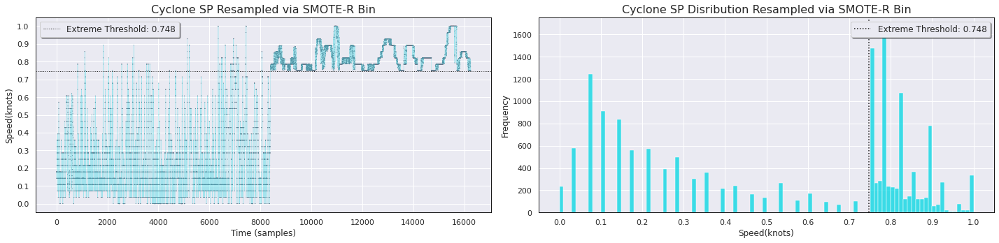

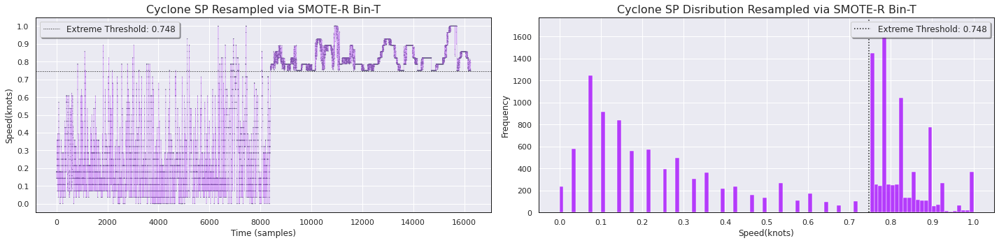

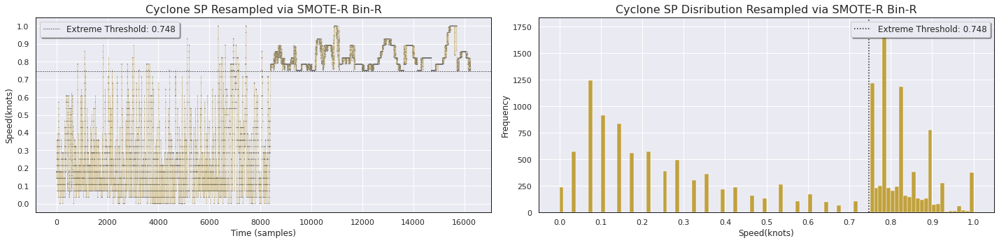

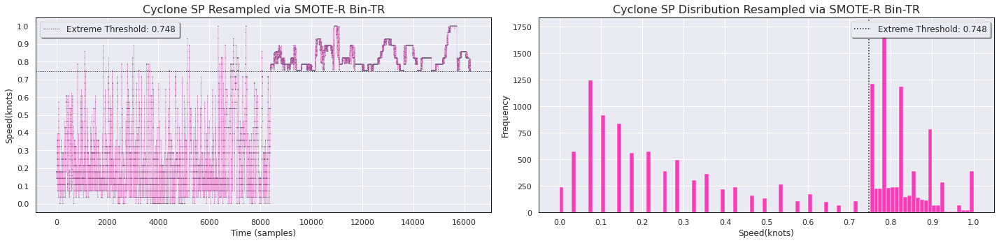

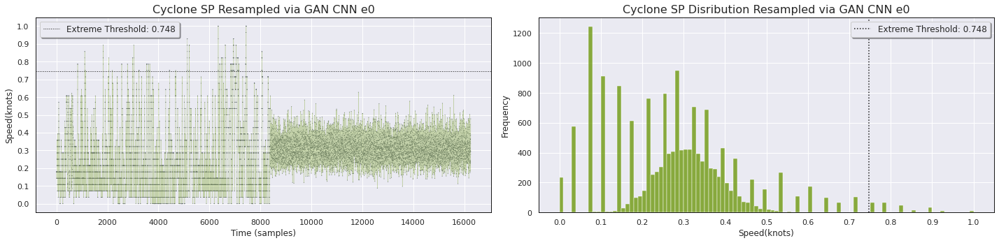

...

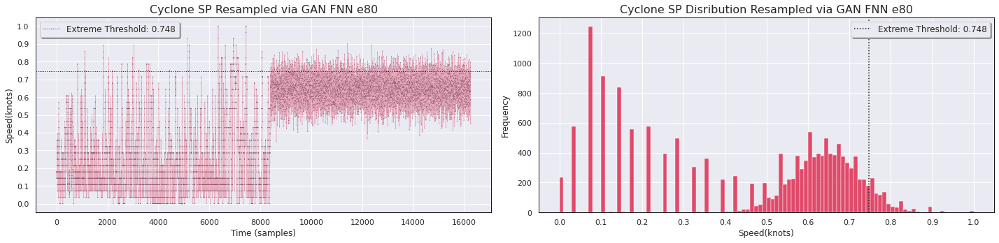

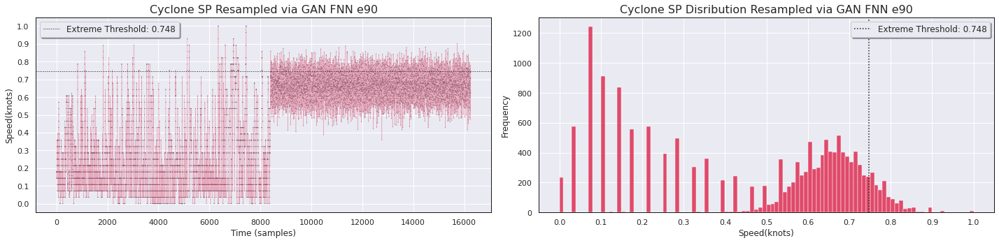

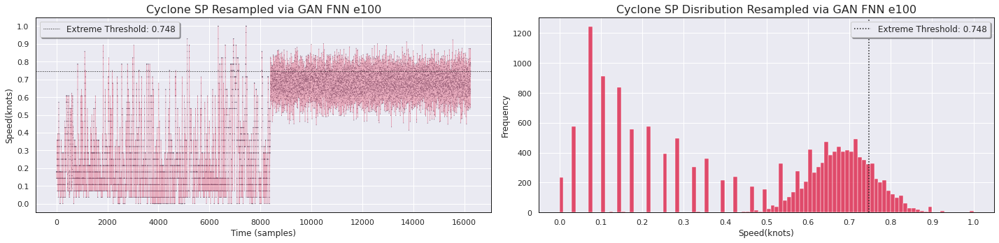

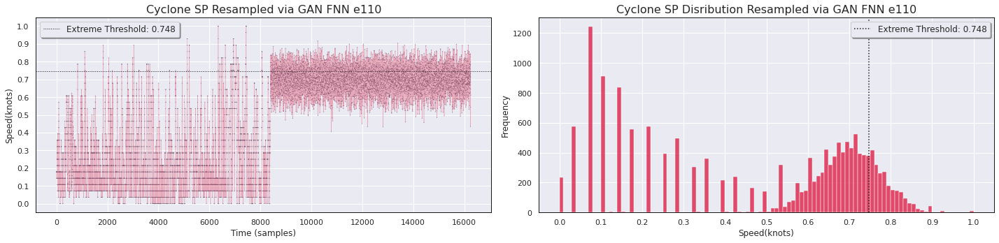

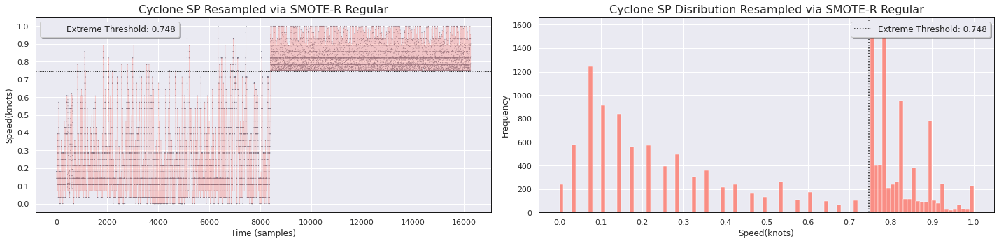

In [11]:
#import plt_utils as pu
#importlib.reload(pu)
#only plots first step out in each embedded
pu.PlotResampledResults(resampling_results, k_X.shape[0], N_STEPS_OUT,EXTREMES_THRESHOLD, TVAR, DATA_NAME)

### Remove Bad GANs

Save time training the forecasters by removing GANs that will clearly generate bad results

In [12]:
all_resampling_results = resampling_results.copy() #save a copy just incase
to_delete = ['GAN_CNN_e0', 'GAN_CNN_e10', 'GAN_CNN_e20', 'GAN_CNN_e30', 'GAN_CNN_e80', 'GAN_CNN_e90', 'GAN_CNN_e50', 'GAN_CNN_e40','GAN_CNN_e100', 'GAN_FNN_e0', 'GAN_FNN_e10', 'GAN_FNN_e20', 'GAN_FNN_e30', 'GAN_FNN_e40', 'GAN_FNN_e50', 'GAN_FNN_e60', 'GAN_FNN_e70', 'GAN_FNN_e80', 'GAN_FNN_e90'] #['GAN_CNN_e10'] #specify resampling results to delete from the dictionary
print(resampling_results.keys())
for d in to_delete:
    del resampling_results[d]
print(resampling_results.keys())

dict_keys(['SMOTER_bin', 'SMOTER_bin_t', 'SMOTER_bin_r', 'SMOTER_bin_tr', 'GAN_CNN_e0', 'GAN_CNN_e10', 'GAN_CNN_e20', 'GAN_CNN_e30', 'GAN_CNN_e40', 'GAN_CNN_e50', 'GAN_CNN_e60', 'GAN_CNN_e70', 'GAN_CNN_e80', 'GAN_CNN_e90', 'GAN_CNN_e100', 'GAN_CNN_e110', 'GAN_FNN_e0', 'GAN_FNN_e10', 'GAN_FNN_e20', 'GAN_FNN_e30', 'GAN_FNN_e40', 'GAN_FNN_e50', 'GAN_FNN_e60', 'GAN_FNN_e70', 'GAN_FNN_e80', 'GAN_FNN_e90', 'GAN_FNN_e100', 'GAN_FNN_e110', 'SMOTER_regular'])
dict_keys(['SMOTER_bin', 'SMOTER_bin_t', 'SMOTER_bin_r', 'SMOTER_bin_tr', 'GAN_CNN_e60', 'GAN_CNN_e70', 'GAN_CNN_e110', 'GAN_FNN_e100', 'GAN_FNN_e110', 'SMOTER_regular'])


# **Running Forecasting Experiments**

**Init Evaluator object for model eval metrics**

In [13]:
import evaluator as ev
importlib.reload(ev)

#NOTE: evaler_params must include CaseWeight else errors in MODEL_LSTM
evaluator_params = { "RMSE": {},
                     "RMSERare": {},
                     "Utility": {'m':0.5},
                     "CaseWeight": {'m':0.5},
                     "PrecisionRecall": {},
                     "FScore": {'beta':0.5},
                     #"RelevanceROC": {},
                   }
EVALERS = {}
for f in FORECASTERS:
    EVALERS[f] = ev.Evaluator(evaluator_params, RELEVANCE_THRESHOLD, RELEVANCE_FUNCTION)

#EVALER = ev.Evaluator(evaluator_params, RELEVANCE_THRESHOLD, RELEVANCE_FUNCTION)
RECORDER.save_param_dict({"Evaluator":evaluator_params})

**Train and evaluate an LSTM for each resampling strategy**

In [14]:
NUM_EXPERIMENTS = 10

def main(time_step, X_train, X_test, Y_train, Y_test, resampling_results, evalers, recorder, train_params):   
    recorder.log_print(f"Starting forecasting experiments with num_exps: {train_params['num_exp']} and epochs: {train_params['epochs']}")
    recorder.save_param_dict({"Forecasting":{"NumExp":train_params['num_exp'], "nEpochs": train_params['epochs'], "hidden":train_params['hidden']}})
    
    forecast_results = {}
    for f in FORECASTERS:
        print(f"############## no_resample : {f} ##############")
        if f == "LSTM":
            best_predict_test, best_predict_train, best_cw, best_model = fmod.MODEL_LSTM(X_train, X_test, Y_train, Y_test, "no_resample", train_params, evalers[f], recorder.log_print)
        else:
            best_predict_test, best_predict_train, best_cw, best_model = fmod.MODEL_CNN(X_train, X_test, Y_train, Y_test, "no_resample", train_params, evalers[f], recorder.log_print)
    
        results = {'predict_test':best_predict_test,'predict_train':best_predict_train,'X_train':X_train,'Y_train':Y_train,'model':best_model}
        forecast_results[f] = {}
        forecast_results[f]['no_resample'] = results
    
    
    for key in resampling_results.keys():
        res = resampling_results[key]
        X_res = res[:,:(N_STEPS_IN*N_FVARS)]
        X_res = X_res.reshape((X_res.shape[0],N_STEPS_IN,N_FVARS))
        Y_res = res[:,(N_STEPS_IN*N_FVARS):]
        for f in FORECASTERS:
            print(f"############## {key} : {f} ##############")
            if f == "LSTM":
                best_predict_test, best_predict_train, best_cw, best_model = fmod.MODEL_LSTM(X_res, X_test, Y_res, Y_test, key, train_params, evalers[f], recorder.log_print)
            else:
                best_predict_test, best_predict_train, best_cw, best_model = fmod.MODEL_CNN(X_res, X_test, Y_res, Y_test, key, train_params, evalers[f], recorder.log_print)
        
            results = {'predict_test':best_predict_test,'predict_train':best_predict_train,'X_train':X_res,'Y_train':Y_res,'model':best_model}
            forecast_results[f][key] = results
    
    return forecast_results

TRAIN_PARAMS = {
        'num_exp': NUM_EXPERIMENTS, 
        'n_steps_in': N_STEPS_IN,
        'n_steps_out': N_STEPS_OUT,
        'epochs': 100,
        'hidden': 100,
        'forecast_dir': FORECAST_DIR,
        'n_fvars': N_FVARS
    }

forecast_results = main(N_STEPS_IN, X_train, X_test, Y_train, Y_test, resampling_results, EVALERS, RECORDER, TRAIN_PARAMS)

print("$$$$ FINISHED FORECASTING EXPERIMENTS $$$$")

LOG: 00:23:21:056 Starting forecasting experiments with num_exps: 10 and epochs: 100

############## no_resample : LSTM ##############
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100)               40800     
                                                                 
 dense (Dense)               (None, 5)                 505       
                                                                 
Total params: 41,305
Trainable params: 41,305
Non-trainable params: 0
_________________________________________________________________
LOG: 00:23:21:198 Starting LSTM forecaster training on no_resample

LOG: 00:23:21:198 	Experiment 1 in progress



2023-11-05 00:23:21.063484: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-11-05 00:23:21.067628: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-11-05 00:23:21.067720: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory
2023-11-05 00:23:21.067770: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory
2023-11-05 00:23:21.067817: W tensorf

113/113 [==============================] - 0s 2ms/step
LOG: 00:24:49:641 	Experiment 2 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:26:16:559 	Experiment 3 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:27:20:380 	Experiment 4 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:28:26:387 	Experiment 5 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:29:32:291 	Experiment 6 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:30:38:600 	Experiment 7 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:31:45:378 	Experiment 8 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:32:51:675 	Experiment 9 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:33:58:069 	Experiment 10 in progress

113/113 [==============================] - 0s 2ms/step
LOG: 00:35:04:586 Total time for 10 no_resam

113/113 [==============================] - 0s 987us/step
LOG: 01:00:29:078 	Experiment 2 in progress

113/113 [==============================] - 0s 964us/step
LOG: 01:01:00:674 	Experiment 3 in progress

113/113 [==============================] - 0s 898us/step
LOG: 01:01:32:355 	Experiment 4 in progress

113/113 [==============================] - 0s 946us/step
LOG: 01:02:04:055 	Experiment 5 in progress

113/113 [==============================] - 0s 933us/step
LOG: 01:02:35:846 	Experiment 6 in progress

113/113 [==============================] - 0s 934us/step
LOG: 01:03:07:494 	Experiment 7 in progress

113/113 [==============================] - 0s 967us/step
LOG: 01:03:39:306 	Experiment 8 in progress

113/113 [==============================] - 0s 947us/step
LOG: 01:04:10:929 	Experiment 9 in progress

113/113 [==============================] - 0s 990us/step
LOG: 01:04:43:008 	Experiment 10 in progress

113/113 [==============================] - 0s 947us/step
LOG: 01:05:14:790 Total 

113/113 [==============================] - 0s 970us/step
LOG: 02:23:49:080 	Experiment 3 in progress

113/113 [==============================] - 0s 942us/step
LOG: 02:24:21:238 	Experiment 4 in progress

113/113 [==============================] - 0s 958us/step
LOG: 02:24:53:340 	Experiment 5 in progress

113/113 [==============================] - 0s 947us/step
LOG: 02:25:25:432 	Experiment 6 in progress

113/113 [==============================] - 0s 937us/step
LOG: 02:25:57:565 	Experiment 7 in progress

113/113 [==============================] - 0s 932us/step
LOG: 02:26:29:701 	Experiment 8 in progress

113/113 [==============================] - 0s 958us/step
LOG: 02:27:01:888 	Experiment 9 in progress

113/113 [==============================] - 0s 939us/step
LOG: 02:27:34:013 	Experiment 10 in progress

113/113 [==============================] - 0s 967us/step
LOG: 02:28:06:171 Total time for 10 SMOTER_bin_tr experiments 321.5779995918274

############## GAN_CNN_e60 : LSTM ###########

113/113 [==============================] - 0s 942us/step
LOG: 03:46:35:179 	Experiment 5 in progress

113/113 [==============================] - 0s 938us/step
LOG: 03:47:07:754 	Experiment 6 in progress

113/113 [==============================] - 0s 937us/step
LOG: 03:47:40:131 	Experiment 7 in progress

113/113 [==============================] - 0s 947us/step
LOG: 03:48:12:411 	Experiment 8 in progress

113/113 [==============================] - 0s 925us/step
LOG: 03:48:44:977 	Experiment 9 in progress

113/113 [==============================] - 0s 935us/step
LOG: 03:49:17:323 	Experiment 10 in progress

113/113 [==============================] - 0s 941us/step
LOG: 03:49:49:622 Total time for 10 GAN_CNN_e110 experiments 325.88974356651306

############## GAN_FNN_e100 : LSTM ##############
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 100)    

113/113 [==============================] - 0s 997us/step
LOG: 05:23:27:179 	Experiment 6 in progress

113/113 [==============================] - 0s 986us/step
LOG: 05:24:02:862 	Experiment 7 in progress

113/113 [==============================] - 0s 984us/step
LOG: 05:24:38:537 	Experiment 8 in progress

113/113 [==============================] - 0s 999us/step
LOG: 05:25:14:178 	Experiment 9 in progress

113/113 [==============================] - 0s 983us/step
LOG: 05:25:49:823 	Experiment 10 in progress

113/113 [==============================] - 0s 988us/step
LOG: 05:26:25:576 Total time for 10 SMOTER_regular experiments 357.7499499320984

$$$$ FINISHED FORECASTING EXPERIMENTS $$$$


## *SAVE EVALER RESULTS ---- DON'T FORGET*

In [15]:
for f in FORECASTERS:
    RECORDER.save_all_evaler_exps(EVALERS[f].getResultsDf(), f)
    RECORDER.save_summary_evaler(f)

### Plot Actual vs Predicted

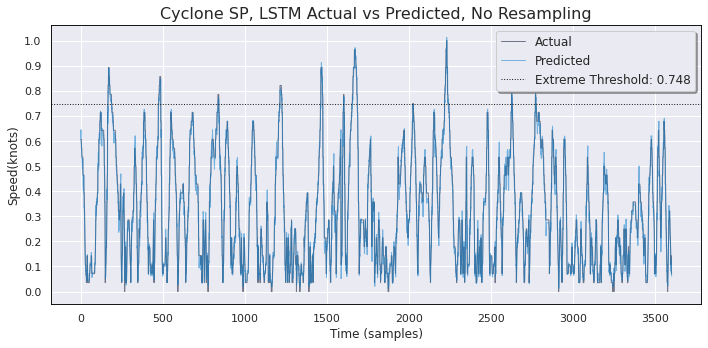

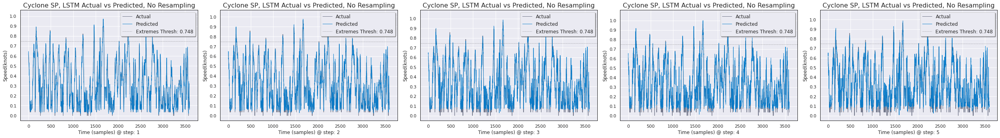

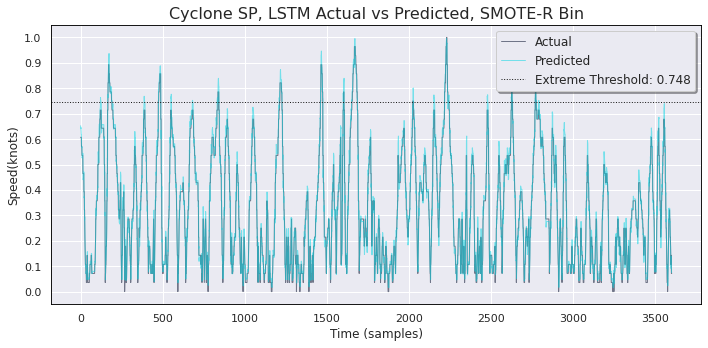

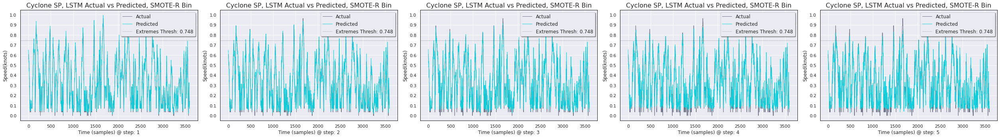

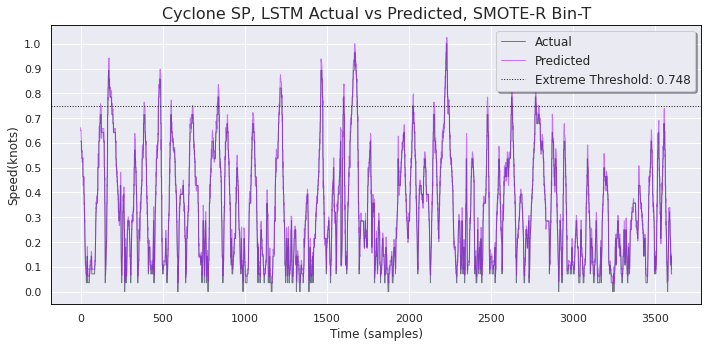

...

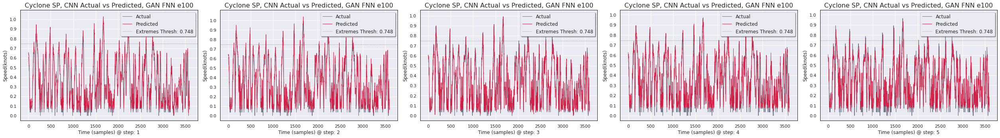

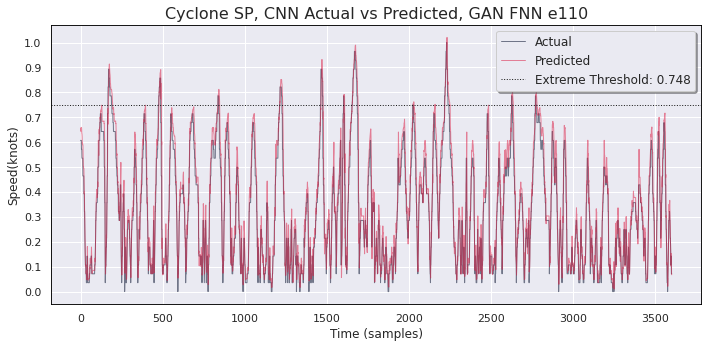

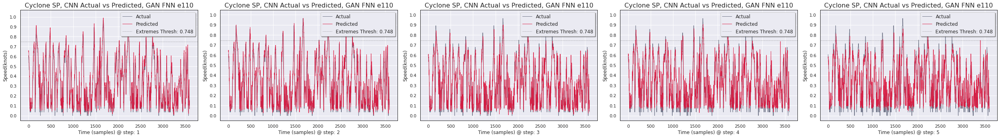

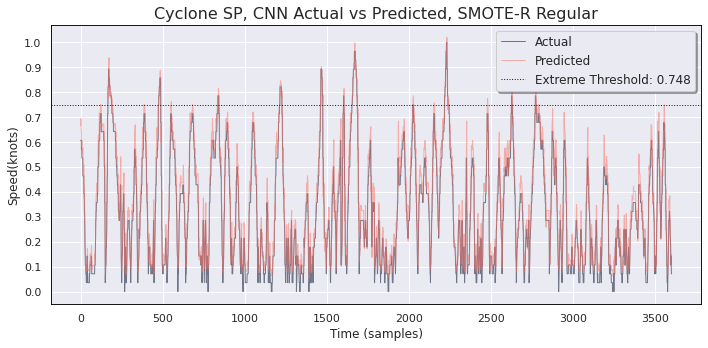

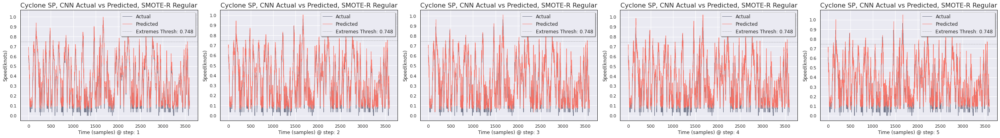

In [16]:
#Uncomment if you want to change stuff in plt_utils mid-session
#import plt_utils as pu
#importlib.reload(pu)
#Need to uncomment this is you're saving figures:
#pu.set_save_figs(True, RECORDER.figures_path)
#print(forecast_results)
#PLOT PRED VS ACTUAL + SAVE_EVAL_RESULTS
for f in FORECASTERS:
    for key in forecast_results[f].keys():
        y_predict_test = forecast_results[f][key]['predict_test']
        #Plot a single Actual vs Predicted figure for only one chosen step out: 0 for first step
        pu.PlotPredVsActual1D(Y_test, y_predict_test, key, EXTREMES_THRESHOLD, TVAR, DATA_NAME, f, 0)
        #Plot a Actual vs Predicted for all steps out in one figure
        pu.PlotPredVsActualSteps(Y_test, y_predict_test, key, EXTREMES_THRESHOLD, TVAR, DATA_NAME, N_STEPS_OUT, f)
        #Save forecasting model
        RECORDER.save_LSTM(forecast_results[f][key]['model'], key)
        #TODO: save CNN and LSTM with same function

### Record KS Statistic and Plot Extremes Distribution for Each Resampling Strategy

KS statistic: 0.10515915557706947, p-value: 0.006589369676107927


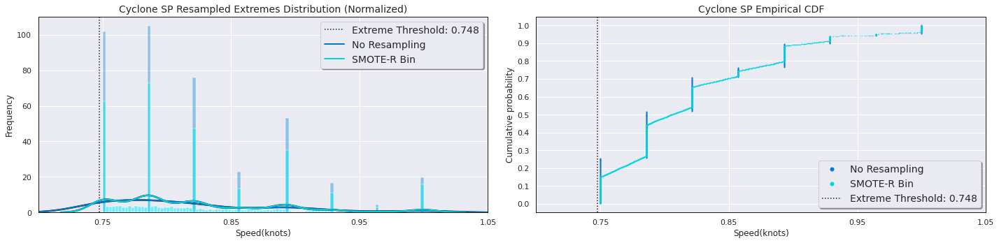

KS statistic: 0.10663662418086163, p-value: 0.005608939273056427


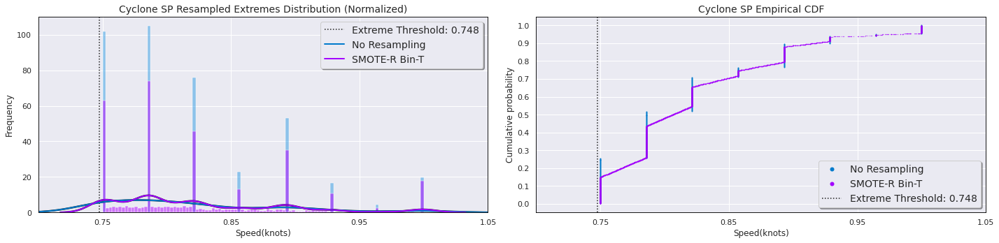

KS statistic: 0.13360042620006873, p-value: 0.00019931056693173123


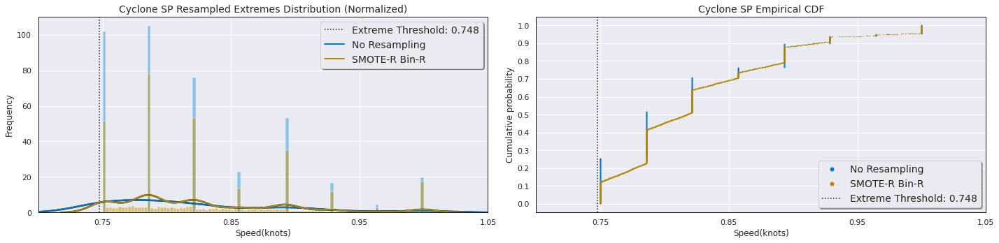

KS statistic: 0.1345854052692635, p-value: 0.00017392963890537145


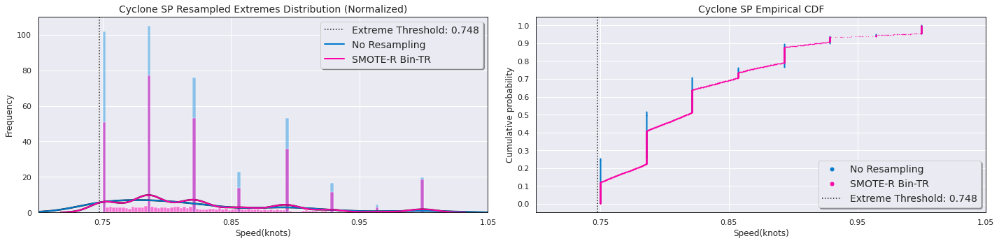

KS statistic: 0.9197897462929864, p-value: 5.779676750180892e-270


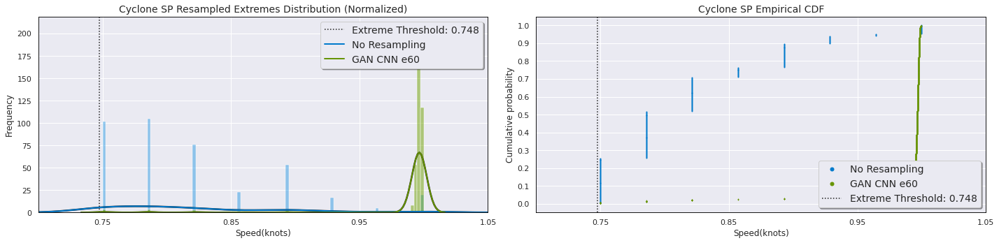

KS statistic: 0.3382105542650601, p-value: 2.1958413710598158e-26


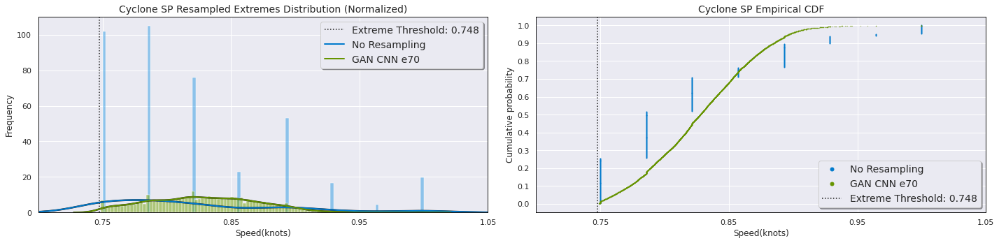

KS statistic: 0.0, p-value: 1.0


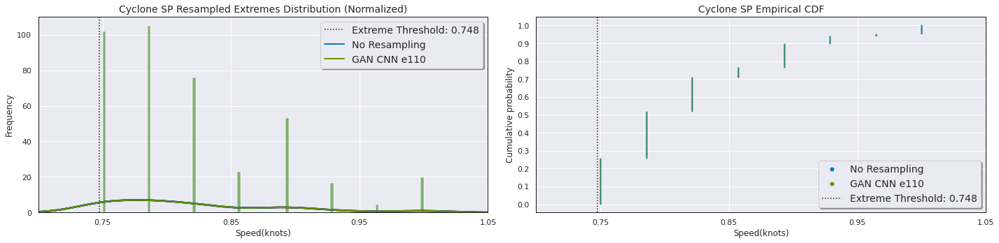

KS statistic: 0.29085226311430884, p-value: 1.5445321419480986e-17


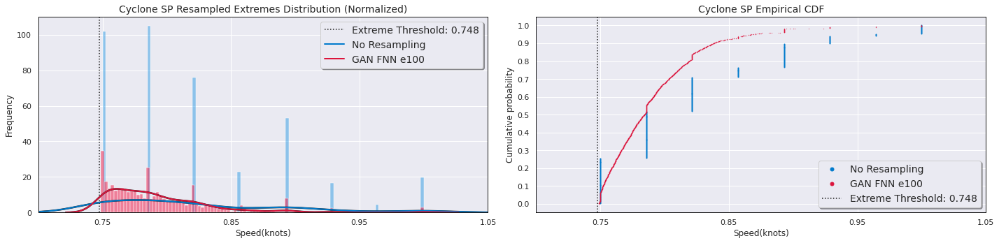

KS statistic: 0.2797095218261699, p-value: 8.94136207635552e-17


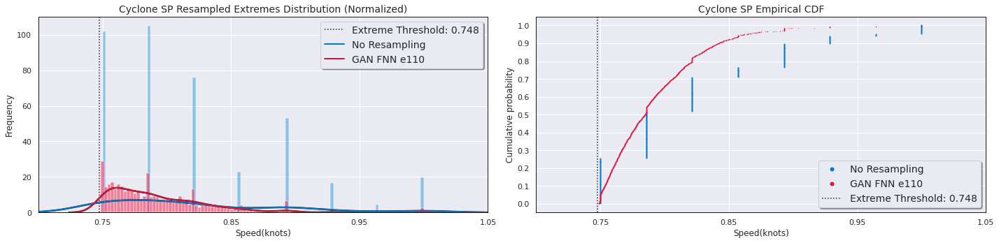

KS statistic: 0.10884012890832226, p-value: 0.004391966693210198


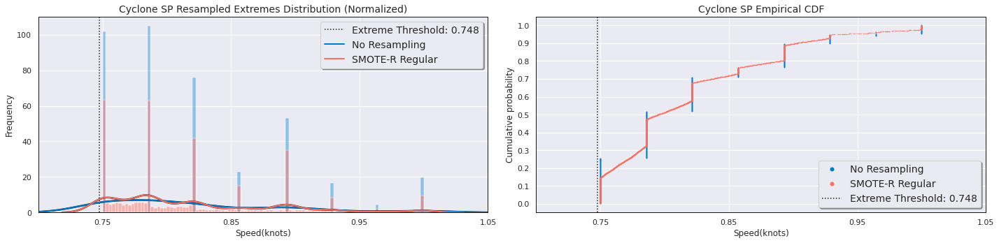

In [17]:
#Uncomment if you want to change stuff in plt_utils mid-session
#import plt_utils as pu
#importlib.reload(pu)
#Need to uncomment this is you're saving figures:
#pu.set_save_figs(True, RECORDER.figures_path)
from scipy.stats import ks_2samp
import scipy.stats as stats

step_out = 0
#get extremes for original data
y_orig_rel = RELEVANCE_FUNCTION.__call__(Y_train[:,step_out])
rare_mask = [val >= RELEVANCE_THRESHOLD for val in y_orig_rel]
y_orig_rare = Y_train[rare_mask]
ks_results = []
for key, res in resampling_results.items():
    #get extremes for resampled data
    y_res = res[:,(N_STEPS_IN*N_FVARS):]
    y_rel = RELEVANCE_FUNCTION.__call__(y_res[:,step_out])
    rare_mask = [val >= RELEVANCE_THRESHOLD for val in y_rel]
    y_rare = y_res[rare_mask]

    # Perform the Kolmogorov-Smirnov test
    statistic, p_value = ks_2samp(y_orig_rare[:,step_out], y_rare[:,step_out])
    print(f"KS statistic: {statistic}, p-value: {p_value}")
    ks_results.append({'Res':key, 'ksStat':statistic, 'pValue':p_value})
    #Plot extremes hist and cdf for each strategy vs original data
    pu.PlotExremesDistribution(y_orig_rare, y_rare, key, step_out, EXTREMES_THRESHOLD, TVAR, DATA_NAME)
    

ks_df = pd.DataFrame(ks_results)
RECORDER.save_ks(ks_df)

### Prepare Data for Comparison Plots

If we include all strategies on the comparison plots they will be really cluttered and almost useless to the reader. In the following cell we choose the best CNN_GAN, FNN_GAN, and SMOTER_bin approach from the RMSERare of the forecasting results and only include these on the comparison plots. 

Later we'll also use this cell to load the base resampling results / eval metrics to include on the comparison plots along side the next generation of resampling strategies

In [18]:
def calculate_mean(lst):
    return sum(lst) / len(lst)

#Combine EVALER from loaded experiments
#Combine resampling results from loaded experiments
#np.loadtxt('test.txt', delimiter=',', dtype=float)

#TODO: come up with a way to make a copy of evaler so we don't have to filter best strategies for the clustered bar plots

#best_resampling_results will contain best GANs, best SMOTERs
best_resampling_results = resampling_results.copy()
best_cnn_gan = ""
best_fnn_gan = ""
best_bin = ""

def get_best_resampling(forecaster, best, evaler, metric, recorder):
    exp_sum = evaler.getExperimentSummaryDf(metric)
    #get best CNN_GAN if used
    cnn_exp_sum = exp_sum[exp_sum['Res'].str.contains("GAN_CNN")]
    if not cnn_exp_sum.empty:
        #apply mean to all rows
        cnn_exp_sum[f"{metric}_Test_Mean"] = cnn_exp_sum[f"{metric}_Test_Mean"].apply(calculate_mean)
        max_cw_idx = cnn_exp_sum[f"{metric}_Test_Mean"].idxmin()
        best_cnn_gan = cnn_exp_sum.at[max_cw_idx, "Res"]
        print(f"Best CNN_GAN for {forecaster}: {best_cnn_gan}")
        keys_to_delete = [key for key in best['resampling_results'].keys() if "GAN_CNN" in key and key != best_cnn_gan]
        print(f"deleting keys: {keys_to_delete}")
        for key in keys_to_delete:
            del best['resampling_results'][key]
        best['cnn_gan'] = best_cnn_gan
        ekey = int(best_cnn_gan.split('_')[-1][1:])
        recorder.save_gan(CNN_GENS[ekey], CNN_DISCS[ekey], "CNN", best_cnn_gan)
    
    #get best FNN_GAN if used
    fnn_exp_sum = exp_sum[exp_sum['Res'].str.contains("GAN_FNN")]
    if not fnn_exp_sum.empty:
        #apply mean to all rows
        fnn_exp_sum[f"{metric}_Test_Mean"] = fnn_exp_sum[f"{metric}_Test_Mean"].apply(calculate_mean)
        max_cw_idx = fnn_exp_sum[f"{metric}_Test_Mean"].idxmin()
        best_fnn_gan = fnn_exp_sum.at[max_cw_idx, "Res"]
        print(f"Best FNN_GAN for {forecaster}: {best_fnn_gan}")
        keys_to_delete = [key for key in best['resampling_results'].keys() if "GAN_FNN" in key and key != best_fnn_gan]
        print(f"deleting keys: {keys_to_delete}")
        for key in keys_to_delete:
            del best['resampling_results'][key]
        best['fnn_gan'] = best_fnn_gan
        ekey = int(best_fnn_gan.split('_')[-1][1:])
        RECORDER.save_gan(FNN_GENS[ekey], FNN_DISCS[ekey], "FNN", best_fnn_gan)
    #get best SMOTER_bin if used
    bin_exp_sum = exp_sum[exp_sum['Res'].str.contains("SMOTER_bin")] 
    if not bin_exp_sum.empty:
        bin_exp_sum[f"{metric}_Test_Mean"] = bin_exp_sum[f"{metric}_Test_Mean"].apply(calculate_mean)
        max_cw_idx = bin_exp_sum[f"{metric}_Test_Mean"].idxmin()
        best_bin = bin_exp_sum.at[max_cw_idx, "Res"]
        print(f"Best SMOTER bin for {forecaster}: {best_bin}")
        keys_to_delete = [key for key in best['resampling_results'].keys() if "SMOTER_bin" in key and key != best_bin]
        print(f"deleting keys: {keys_to_delete}")
        for key in keys_to_delete:
            del best['resampling_results'][key]
        best['bin'] = best_bin
    return best #?
                                                         

BEST_RESULTS = {}
for f in FORECASTERS:
    BEST_RESULTS[f] = {'resampling_results': resampling_results.copy(), 'cnn_gan': "", 'fnn_gan': "", "bin": ""}
    #do below stuff with argument 'f'
    BEST_RESULTS[f] = get_best_resampling(f, BEST_RESULTS[f], EVALERS[f], 'RMSERare', RECORDER) #?
    RECORDER.save_resample_results_np(BEST_RESULTS[f]['resampling_results'], f)


#load all resampling results
#COMBINE_RESAMPLING_RESULTS_DIR = Path("Sessions/Bike/2023-October-13 13-41-03-532984").joinpath("resample_results")

#add loaded resampling results to best_resampling_results
#best_resampling_results.update({file.stem: np.loadtxt(file, delimiter=',', dtype=float)
#                  for file in COMBINE_RESAMPLING_RESULTS_DIR.iterdir() if file.is_file()})

Best CNN_GAN for LSTM: GAN_CNN_e110
deleting keys: ['GAN_CNN_e60', 'GAN_CNN_e70']
Best FNN_GAN for LSTM: GAN_FNN_e100
deleting keys: ['GAN_FNN_e110']
Best SMOTER bin for LSTM: SMOTER_bin_tr
deleting keys: ['SMOTER_bin', 'SMOTER_bin_t', 'SMOTER_bin_r']
Best CNN_GAN for CNN: GAN_CNN_e70
deleting keys: ['GAN_CNN_e60', 'GAN_CNN_e110']
Best FNN_GAN for CNN: GAN_FNN_e100
deleting keys: ['GAN_FNN_e110']
Best SMOTER bin for CNN: SMOTER_bin
deleting keys: ['SMOTER_bin_t', 'SMOTER_bin_r', 'SMOTER_bin_tr']


### Compare KDEs and CDFs

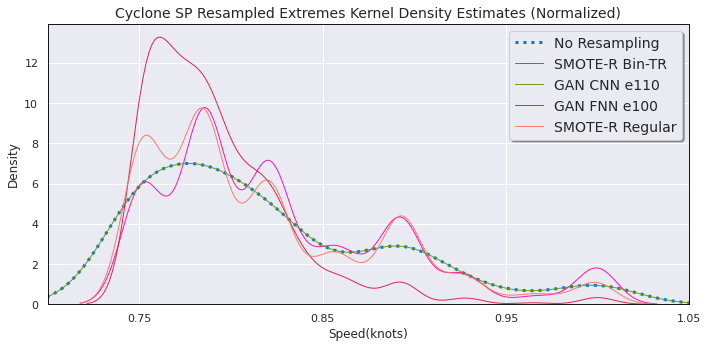

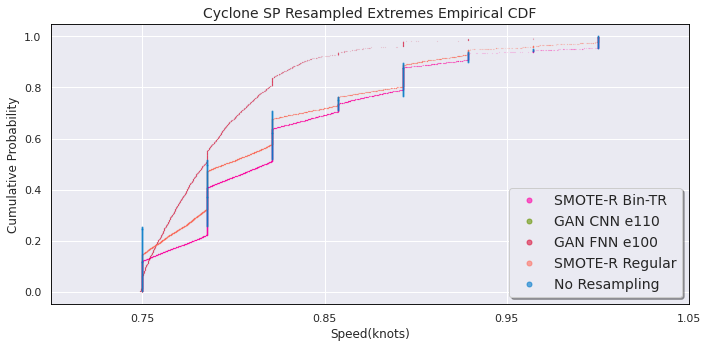

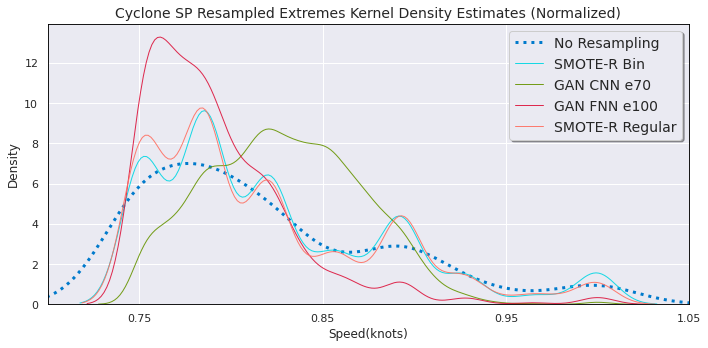

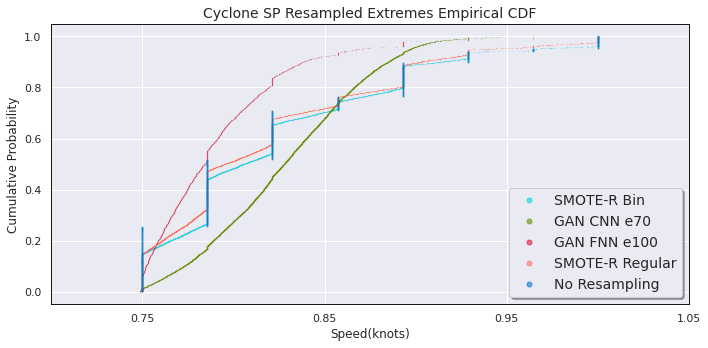

In [19]:
#Uncomment if you want to change stuff in plt_utils mid-session
#import plt_utils as pu
#importlib.reload(pu)
#Need to uncomment this is you're saving figures:
#pu.set_save_figs(True, RECORDER.figures_path)
step_out = 0

#compare KDE, CDF
for f in FORECASTERS:
    pu.PlotKDECompare(Y_train, BEST_RESULTS[f]['resampling_results'], RELEVANCE_FUNCTION, RELEVANCE_THRESHOLD, step_out, N_STEPS_IN*N_FVARS, EXTREMES_THRESHOLD, TVAR, DATA_NAME, f)    
    pu.PlotCDFCompare(Y_train, BEST_RESULTS[f]['resampling_results'], RELEVANCE_FUNCTION, RELEVANCE_THRESHOLD, step_out, N_STEPS_IN*N_FVARS, EXTREMES_THRESHOLD, TVAR, DATA_NAME, f)    

### Plot Eval Results Aggregated Over All Steps

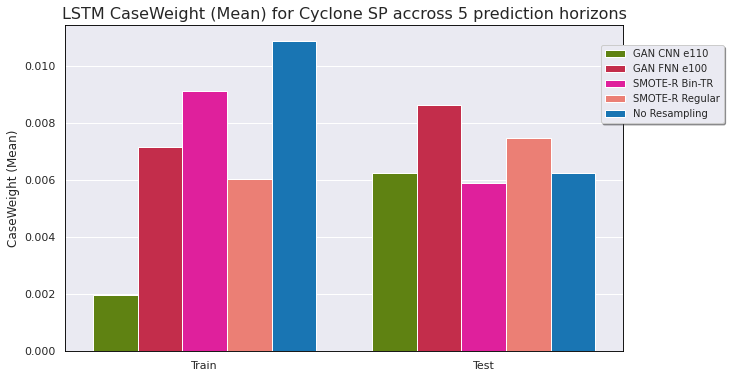

<Figure size 720x432 with 0 Axes>

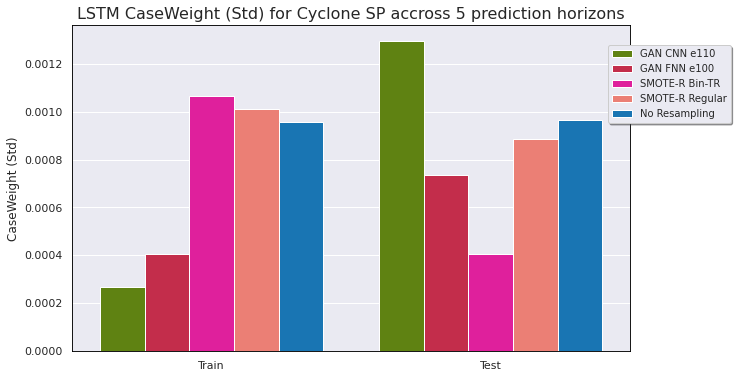

<Figure size 720x432 with 0 Axes>

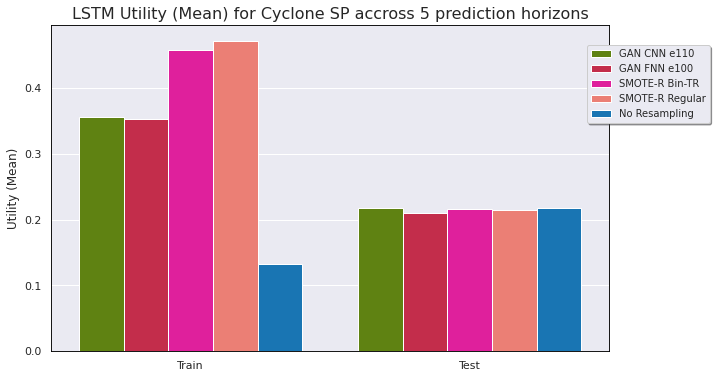

<Figure size 720x432 with 0 Axes>

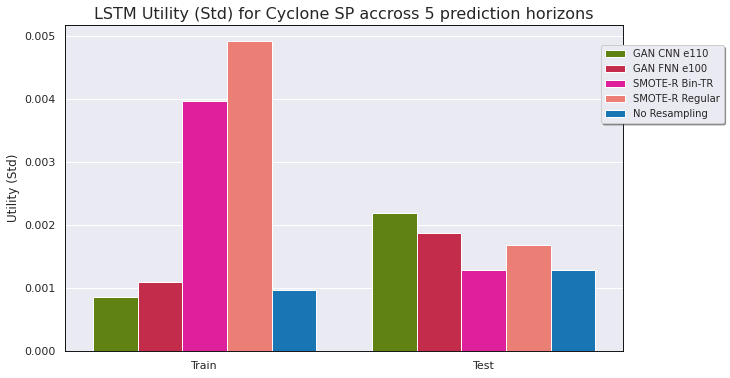

<Figure size 720x432 with 0 Axes>

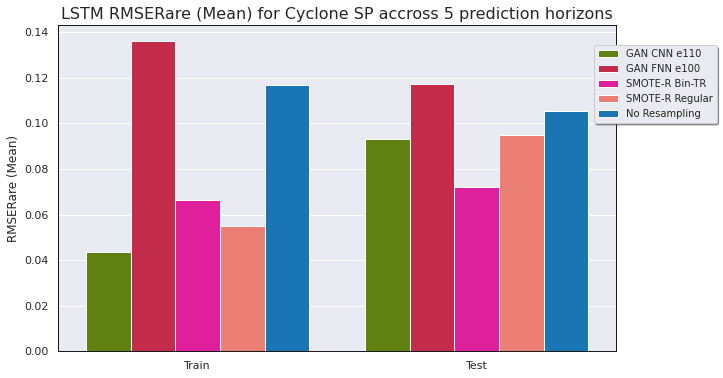

<Figure size 720x432 with 0 Axes>

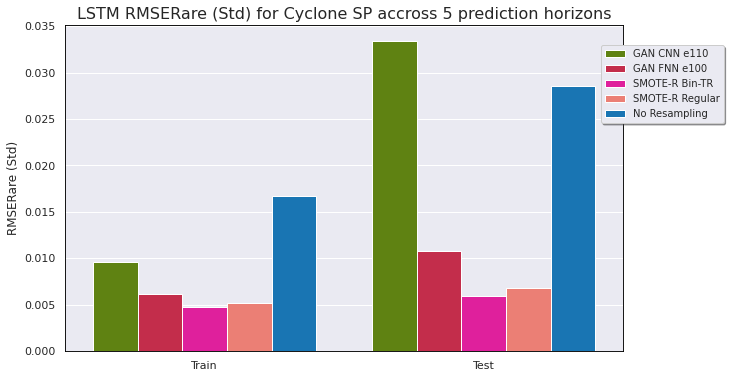

<Figure size 720x432 with 0 Axes>

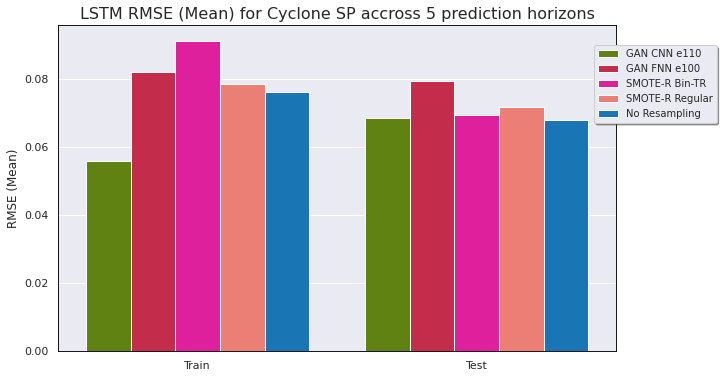

<Figure size 720x432 with 0 Axes>

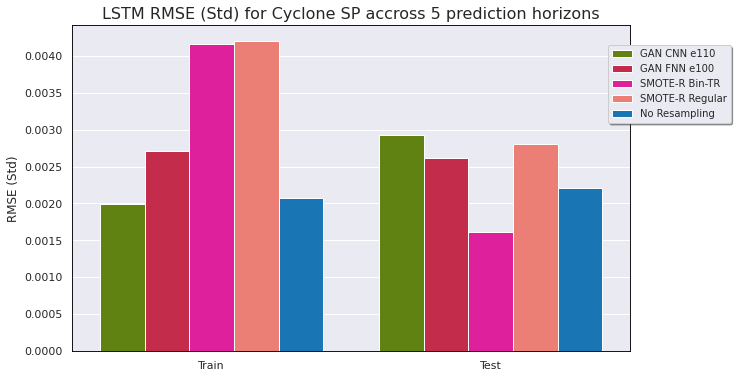

<Figure size 720x432 with 0 Axes>

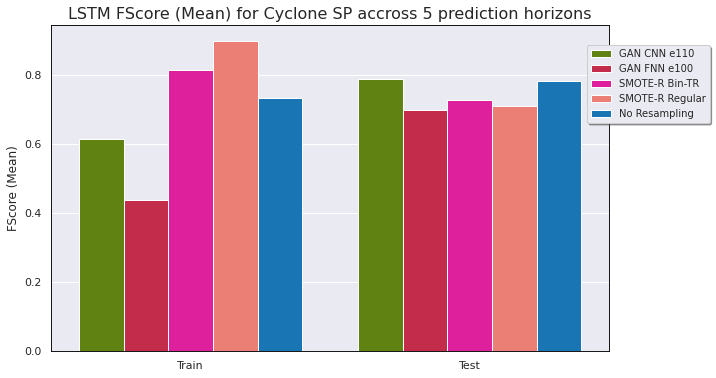

<Figure size 720x432 with 0 Axes>

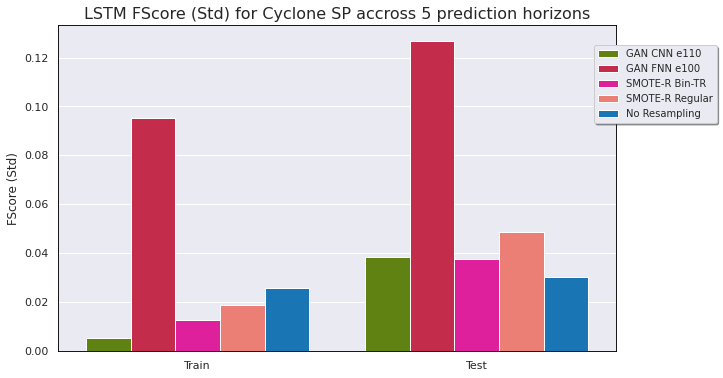

<Figure size 720x432 with 0 Axes>

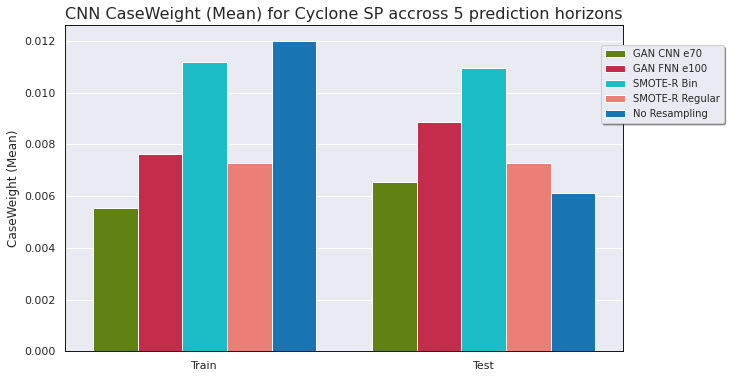

<Figure size 720x432 with 0 Axes>

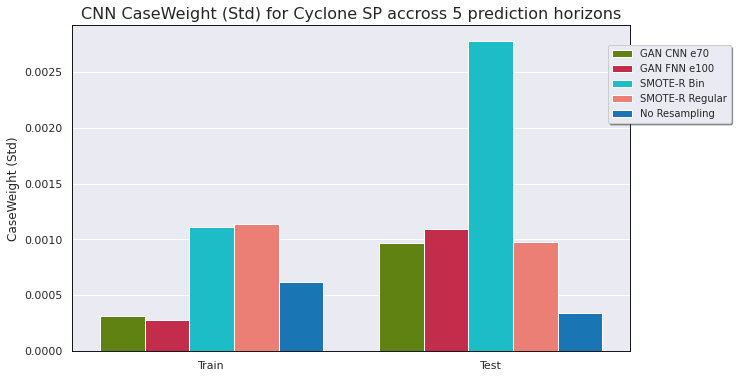

<Figure size 720x432 with 0 Axes>

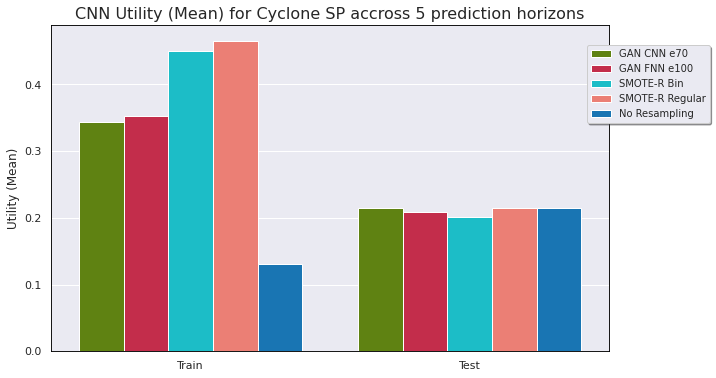

<Figure size 720x432 with 0 Axes>

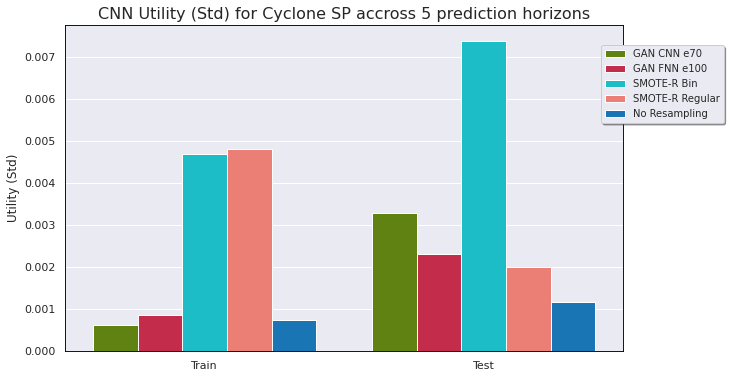

<Figure size 720x432 with 0 Axes>

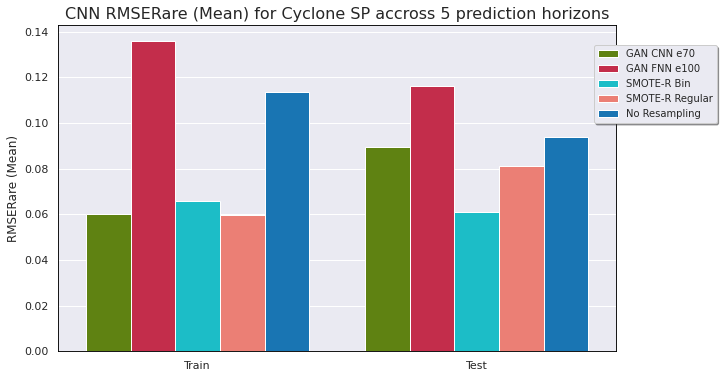

<Figure size 720x432 with 0 Axes>

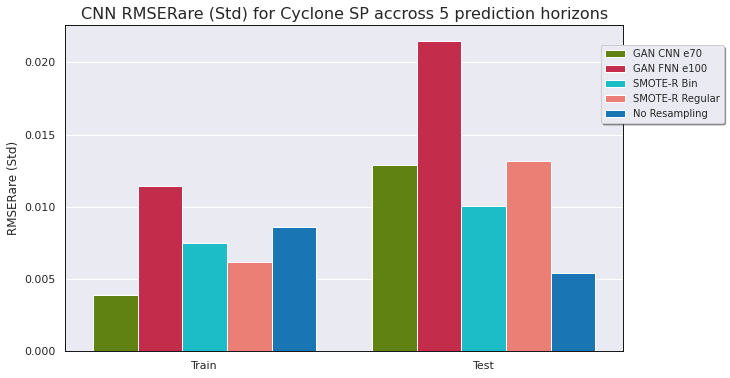

<Figure size 720x432 with 0 Axes>

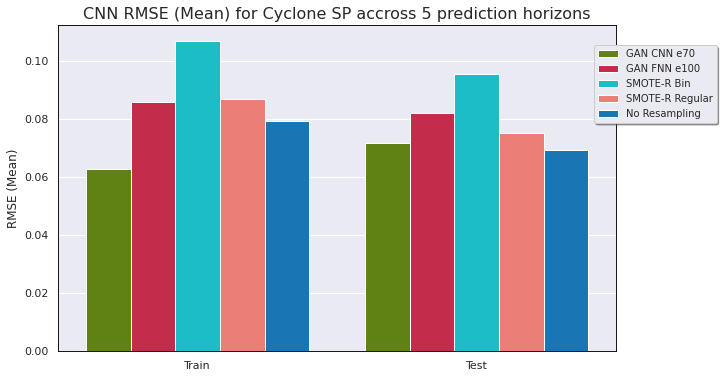

<Figure size 720x432 with 0 Axes>

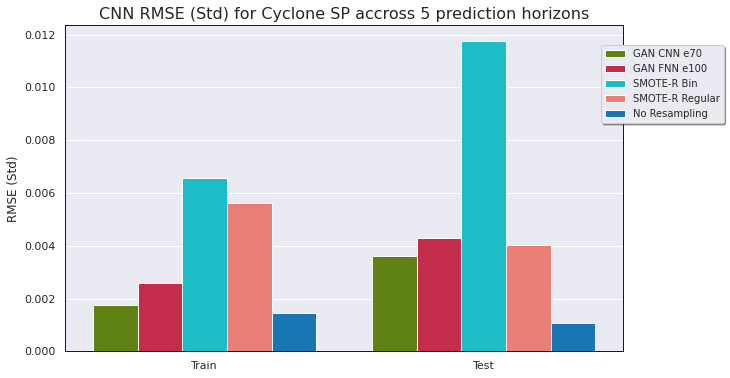

<Figure size 720x432 with 0 Axes>

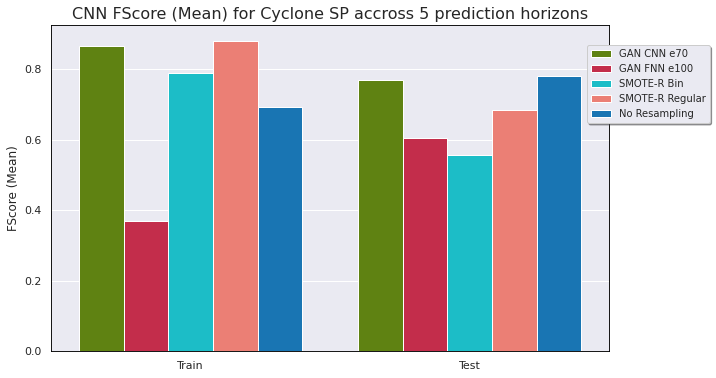

<Figure size 720x432 with 0 Axes>

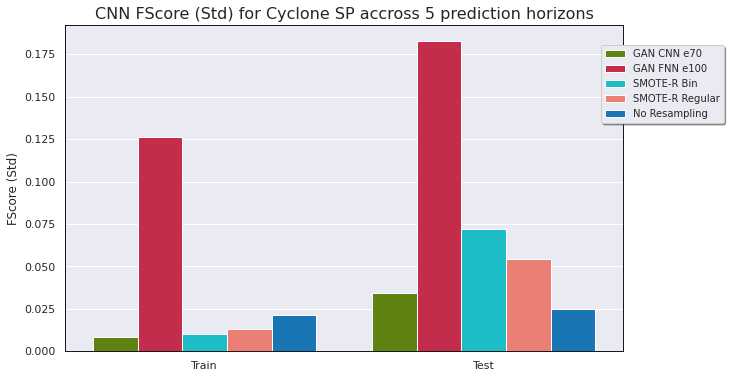

<Figure size 720x432 with 0 Axes>

In [20]:
#Uncomment if you want to change stuff in plt_utils mid-session
#import plt_utils as pu
#importlib.reload(pu)
#Need to uncomment this is you're saving figures:
#pu.set_save_figs(True, RECORDER.figures_path)


def calculate_mean(lst):
    return sum(lst) / len(lst)

#Just plot these metrics:
plot_metrics = ["CaseWeight", "Utility", "RMSERare", "RMSE", "FScore"]

ts = ["Train", "Test"] #one cluster for train, one for test results

#aggs options: 
aggs = ["Mean", "Std"]
## for "Mean" we get the mean of the eval metrics over all experiments and plot its average over time steps
## for "Std" we get the std of the eval metrics over all experiments and plot its average over time steps

#for f in FORECASTERS: EVALER[f], get best_cnn_gan, best_fnn_gan, best_bin from dict
#pass an argument to plotting function to specify f
for f in FORECASTERS:
    best_cnn_gan = BEST_RESULTS[f]['cnn_gan']
    best_fnn_gan = BEST_RESULTS[f]['fnn_gan']
    best_bin = BEST_RESULTS[f]['bin']
    for metric in plot_metrics:
        df_results = EVALERS[f].getExperimentSummaryDf(metric, True)
        df_results_train = EVALERS[f].getExperimentSummaryDf(metric, False)
        df_results[f"{metric}_Train_Mean"] = df_results_train[f"{metric}_Train_Mean"]
        df_results[f"{metric}_Train_Std"] = df_results_train[f"{metric}_Train_Std"]
        # Replace with the mean of the steps out lists
        df_results[f"{metric}_Train_Mean"] = df_results[f"{metric}_Train_Mean"].apply(calculate_mean)
        df_results[f"{metric}_Test_Mean"] = df_results[f"{metric}_Test_Mean"].apply(calculate_mean)
        df_results[f"{metric}_Train_Std"] = df_results[f"{metric}_Train_Std"].apply(calculate_mean)
        df_results[f"{metric}_Test_Std"] = df_results[f"{metric}_Test_Std"].apply(calculate_mean)
        for a in aggs:
            #remove any GAN_CNNs, GAN_FNNs, and SMOTER_bin strategies from the dataframe that aren't the best
            filtered_df = df_results[((df_results['Res'].str.contains('GAN_CNN|GAN_FNN')) & ((df_results['Res'] == best_cnn_gan) | (df_results['Res'] == best_fnn_gan))) | (~df_results['Res'].str.contains('GAN_CNN|GAN_FNN'))]
            filtered_df = filtered_df[((filtered_df['Res'].str.contains('SMOTER_bin')) & (filtered_df['Res'] == best_bin)) | (~filtered_df['Res'].str.contains('SMOTER_bin'))]
            '''
            filtered_df = df_results
            if best_cnn_gan:
                filtered_df = filtered_df[((filtered_df['Res'].str.contains('GAN_CNN')) & (filtered_df['Res'] == best_cnn_gan)) | (~filtered_df['Res'].str.contains('GAN_CNN'))]
            if best_fnn_gan:
                filtered_df = filtered_df[((filtered_df['Res'].str.contains('GAN_FNN')) & (filtered_df['Res'] == best_fnn_gan)) | (~filtered_df['Res'].str.contains('GAN_FNN'))]
            '''
            pu.PlotTrainTestBarResults(filtered_df, metric, a, DATA_NAME, N_STEPS_OUT, f)


### Plot Train and Test Eval Results Clustered By Steps Out

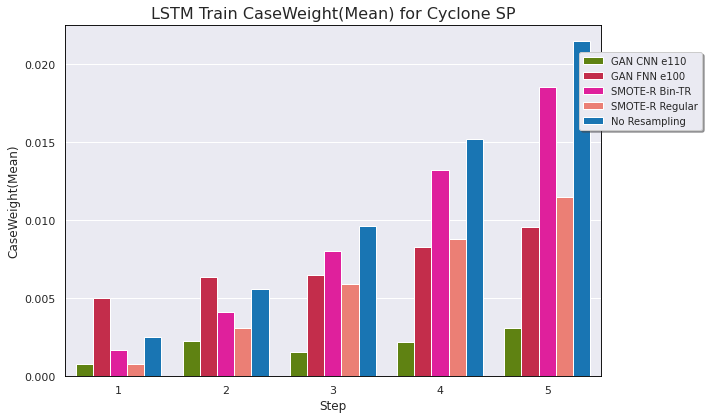

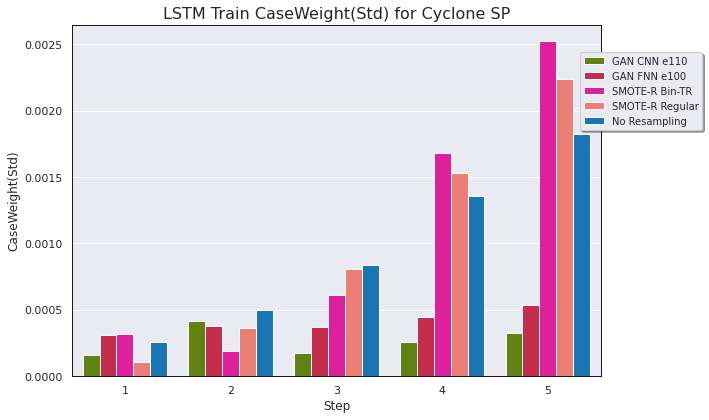

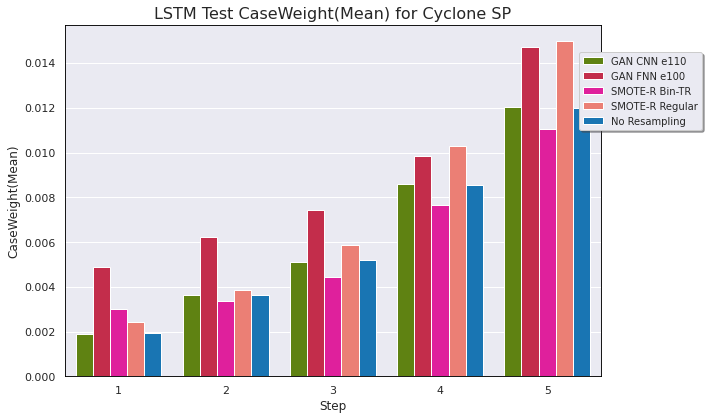

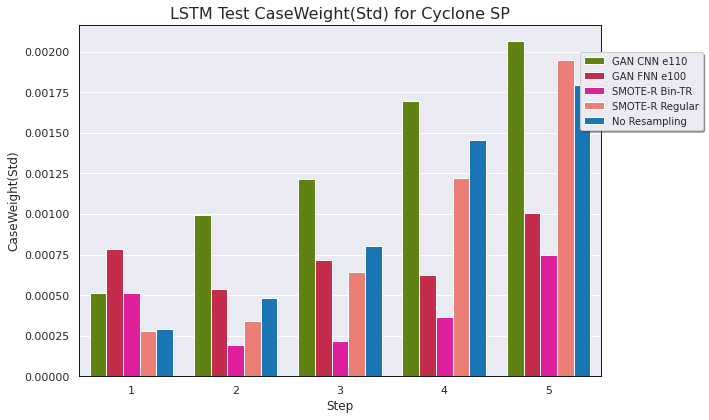

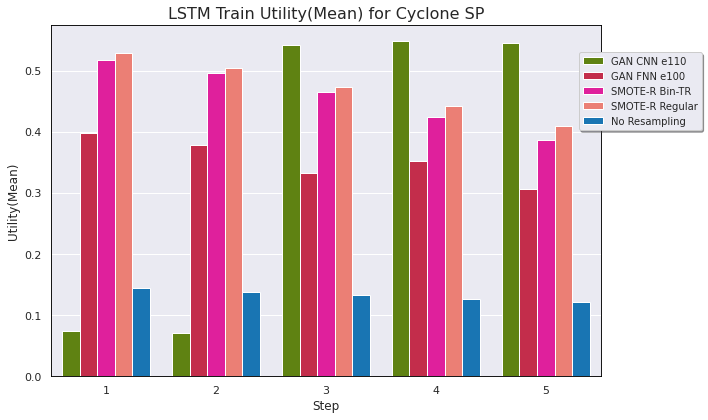

...

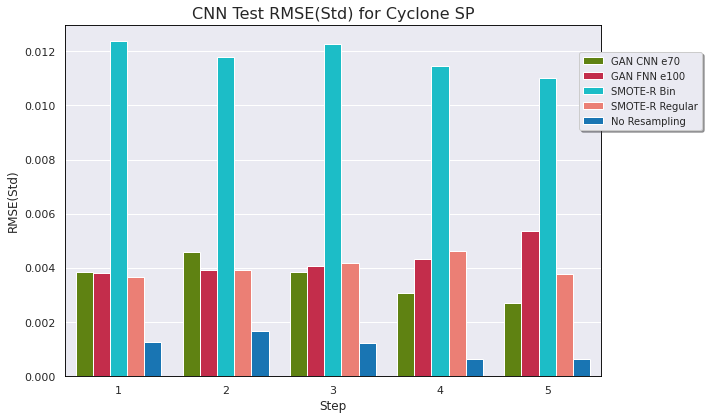

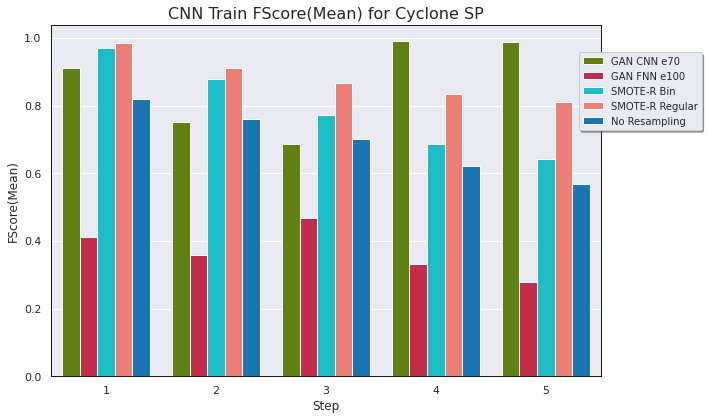

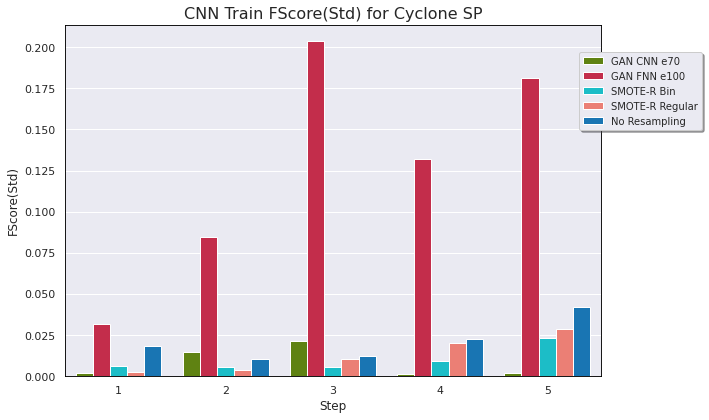

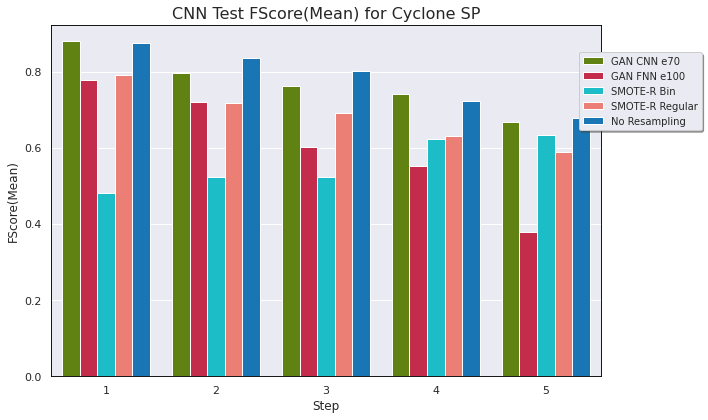

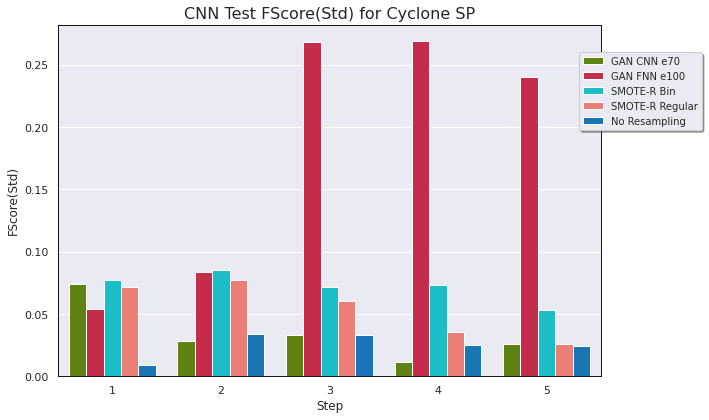

In [21]:
#Uncomment if you want to change stuff in plt_utils mid-session
#import plt_utils as pu
#importlib.reload(pu)
#Need to uncomment this is you're saving figures:
#pu.set_save_figs(True, RECORDER.figures_path)



plot_metrics = ["CaseWeight", "Utility", "RMSERare", "RMSE", "FScore"]
ts = ["Train", "Test"]
aggs = ["Mean", "Std"]
#either plot mean or std of the experiments
for f in FORECASTERS:
    best_cnn_gan = BEST_RESULTS[f]['cnn_gan']
    best_fnn_gan = BEST_RESULTS[f]['fnn_gan']
    best_bin = BEST_RESULTS[f]['bin']
    for metric in plot_metrics:
        for t in ts:
            tb = True if t == "Test" else False
            df_results = EVALERS[f].getExperimentSummaryDf(metric, tb)
            for a in aggs:
                #filter out all GAN_CNNs, GAN_FNNs or SMOTER_bins that aren't the best
                filtered_df = df_results[((df_results['Res'].str.contains('GAN_CNN|GAN_FNN')) & ((df_results['Res'] == best_cnn_gan) | (df_results['Res'] == best_fnn_gan))) | (~df_results['Res'].str.contains('GAN_CNN|GAN_FNN'))]
                filtered_df = filtered_df[((filtered_df['Res'].str.contains('SMOTER_bin')) & (filtered_df['Res'] == best_bin)) | (~filtered_df['Res'].str.contains('SMOTER_bin'))]
                pu.PlotStepBarResults(filtered_df, metric, a, t, DATA_NAME, N_STEPS_OUT, f)